In [1]:
import os
import shutil
from tqdm.notebook import tqdm as tqdm
from PIL import ImageFont, ImageDraw, Image
from IPython.display import display
from IPython.display import Image as im
import numpy as np
import matplotlib.pyplot as plt
import ipyplot
import cv2
%matplotlib inline

In [22]:
rootDirectory = r'F:\SPAD_for_DiffusionModel\1mmUKphant_Gated_Results\3by3'
imageList=[os.path.join(rootDirectory, o) for o in os.listdir(rootDirectory)]
imageList=[file for file in imageList if file.endswith(".jpg")]
print(len(imageList))

200


In [23]:
imageName=imageList[0]
imageName

'F:\\SPAD_for_DiffusionModel\\1mmUKphant_Gated_Results\\3by3\\rCBF_image0_3by3_255.jpg'

In [27]:
allTest='Test_all'
allTrain='Train_all'
allSplitImage='Splitted_ByFolder'

In [28]:
def makeDirectory(folderName,rootAddress=rootDirectory):
    directoryName=folderName
    directoryFullName=os.path.join(rootAddress, directoryName)

    if not os.path.exists(directoryFullName):
        os.makedirs(directoryFullName)
    else:
        shutil.rmtree(directoryFullName)           # Removes all the subdirectories!
        os.makedirs(directoryFullName)
    return directoryFullName

In [29]:
allTestDir=makeDirectory(allTest,rootDirectory)
allTrainDir=makeDirectory(allTrain,rootDirectory)
allSplitImageDir=makeDirectory(allSplitImage,rootDirectory)

Image type <class 'numpy.ndarray'>
Ground Truth image shape: (256, 512, 3)


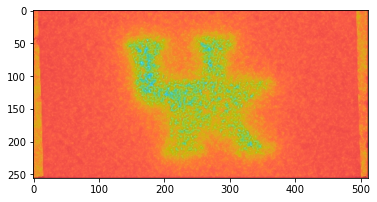

In [4]:
image = cv2.imread(imageName, cv2.IMREAD_COLOR)
print('Image type',type(image))
imageShape=image.shape
print('Ground Truth image shape:',imageShape)
plt.imshow(image)
plt.show()

Test Shape: (256, 256, 3) Train Shape: (256, 256, 3)


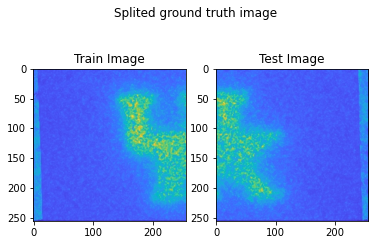

In [5]:
    imageTrain=image[:,:int(imageShape[1]/2),:]
    imageTest=image[:,int(imageShape[1]/2):,:]
    print('Test Shape:',imageTest.shape, 'Train Shape:',imageTrain.shape)
    fig, axs = plt.subplots(nrows=1,ncols=2)
    axs[0].imshow(cv2.cvtColor(imageTrain, cv2.COLOR_BGR2RGB))
    axs[0].set_title('Train Image')
    axs[1].imshow(cv2.cvtColor(imageTest, cv2.COLOR_BGR2RGB))
    axs[1].set_title('Test Image')
    fig.suptitle('Splited ground truth image')
    plt.show()

In [6]:
    imageTestX,imageTestY,_=imageTest.shape
    imageTrainX,imageTrainY,_=imageTrain.shape
    PixelsX=64
    deltaX=32
    PixelsY=64
    deltaY=32
    listTestImages = [imageTest[x:x+PixelsX,y:y+PixelsY] for x in range(0,imageTestX-PixelsX,deltaX) for y in range(0,imageTestY-PixelsY,deltaY)]
    listTrainImages = [imageTrain[x:x+PixelsX,y:y+PixelsY] for x in range(0,imageTrainX-PixelsX,deltaX) for y in range(0,imageTrainY-PixelsY,deltaY)]
    
    firstTestShape=listTestImages[0].shape; print('First test image shape',firstTestShape)
    firstTrainShape=listTrainImages[0].shape; print('First train image shape',listTrainImages[0].shape)
    print('Images in test set:',len(listTestImages))
    print('Images in train set:',len(listTrainImages))

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 36
Images in train set: 36


All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 72


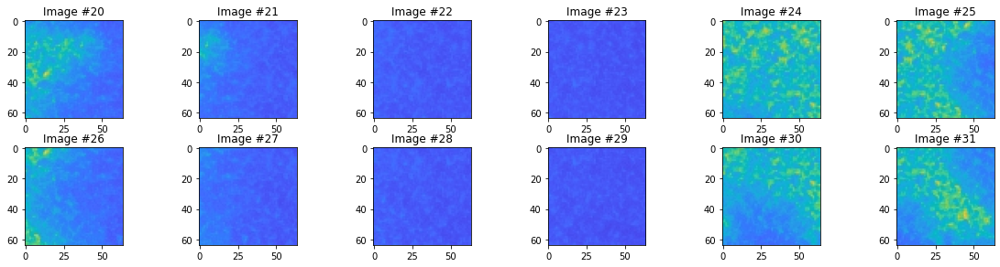

In [7]:
    T=[firstTestShape==listTestImages[i].shape for i in range(len(listTestImages))]
    print('All test images have same shape:',sum(T)==len(listTestImages))
    T=[firstTrainShape==listTrainImages[i].shape for i in range(len(listTrainImages))]
    print('All train images have same shape:',sum(T)==len(listTrainImages))
    print('Length of train plus test set:',len(listTrainImages)+(len(listTestImages)))
    columnN=6
    rowN=2
    imageNumber=20
    fig, axs = plt.subplots(nrows=rowN,ncols=columnN,figsize=(16, 4))
    fig.tight_layout()

    for ii in range(rowN):
        for jj in range(columnN):
            axs[ii,jj].imshow(cv2.cvtColor(listTestImages[imageNumber], cv2.COLOR_BGR2RGB))
            axs[ii,jj].set_title('Image #'+str(imageNumber))
            imageNumber+=1
    plt.show() 

In [31]:
imageFolderName=(str(imageName)).split('\\')[-1][:-4]
imageFolderName

'rCBF_image0_3by3_255'

In [32]:
imageFolderDir=makeDirectory(imageFolderName,allSplitImageDir)
imageFolderTestDir=makeDirectory('Test',imageFolderDir)
imageFolderTrainDir=makeDirectory('Train',imageFolderDir)

In [36]:
    imageType='.jpg'

    # Test
    for ii in range(len(listTestImages)):
        namePrefix='{:05}'.format(ii+1)
        imageName=os.path.join(imageFolderTestDir, (namePrefix+imageType))
        cv2.imwrite(imageName, listTestImages[ii])
        imageName_=os.path.join(allTestDir, (imageFolderName+ '_' + namePrefix+imageType))
        cv2.imwrite(imageName_, listTestImages[ii])

In [37]:
    imageType='.jpg'

    # Train
    for ii in range(len(listTrainImages)):
        namePrefix='{:05}'.format(ii+1)
        imageName=os.path.join(imageFolderTrainDir, (namePrefix+imageType))
        cv2.imwrite(imageName, listTrainImages[ii])
        imageName_=os.path.join(allTrainDir, (imageFolderName+ '_' + namePrefix+imageType))
        cv2.imwrite(imageName_, listTrainImages[ii])

83
['F:\\2D_Imaging_UH3_Proposal\\3mm_30sources_80mW_2ms_1', 'F:\\2D_Imaging_UH3_Proposal\\3mm_30sources_80mW_5ms_1', 'F:\\2D_Imaging_UH3_Proposal\\NR', 'F:\\2D_Imaging_UH3_Proposal\\R']
81
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


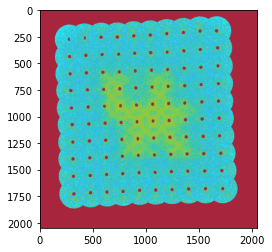

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


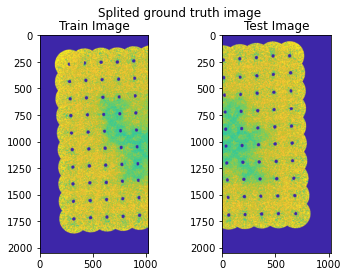

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


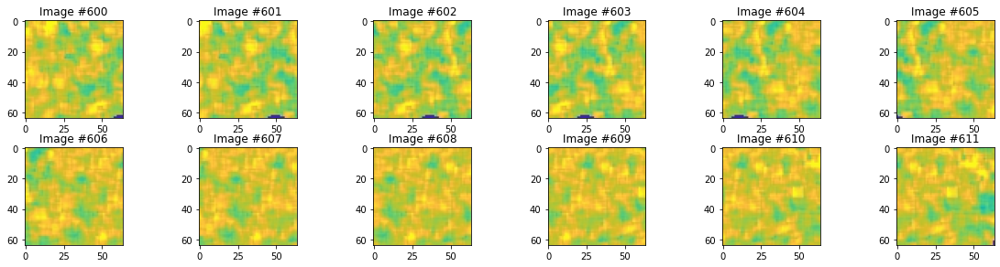

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


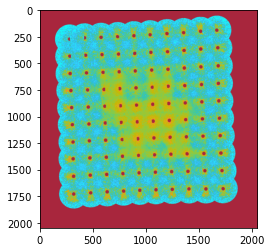

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


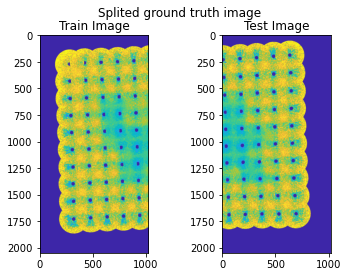

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


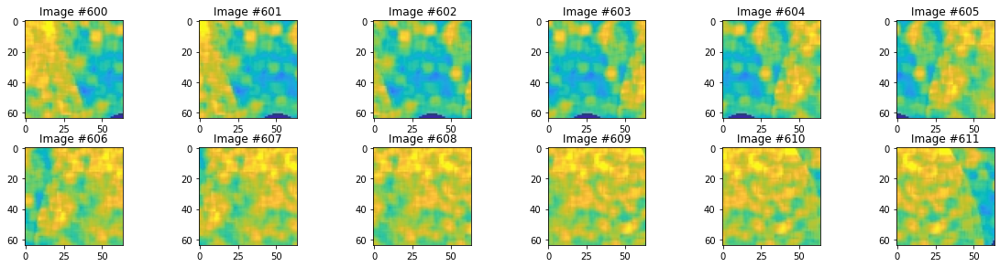

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


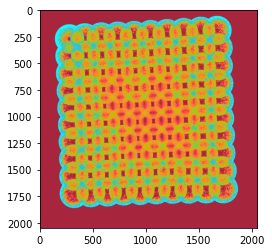

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


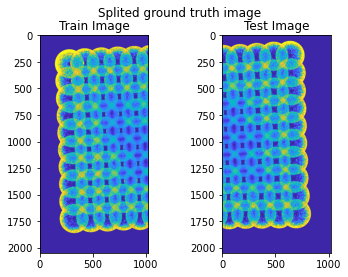

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


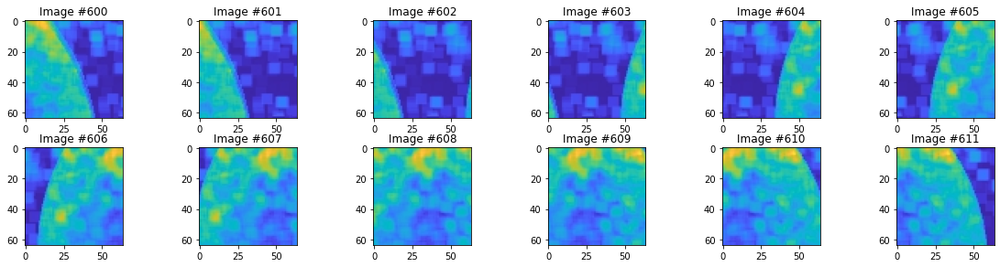

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


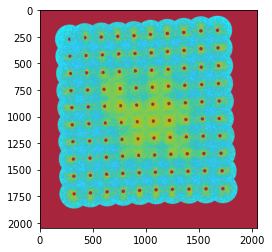

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


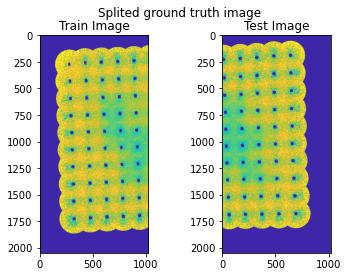

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


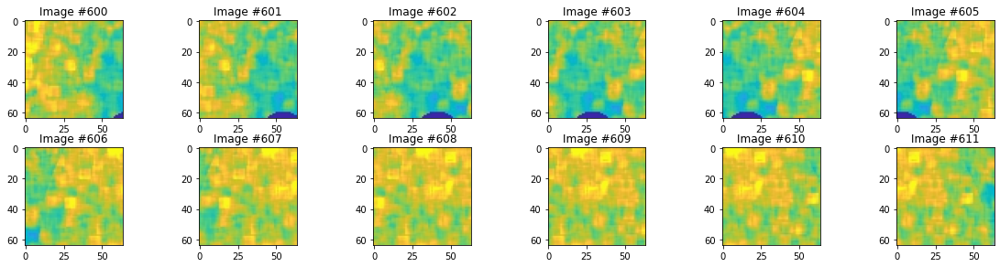

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


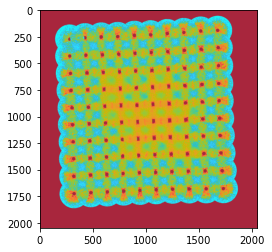

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


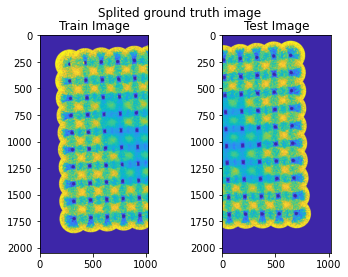

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


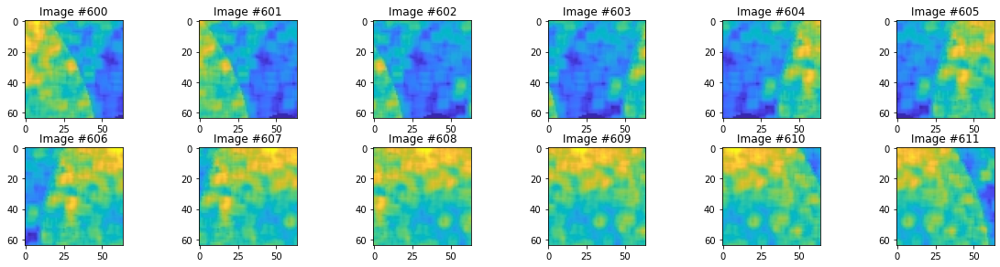

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


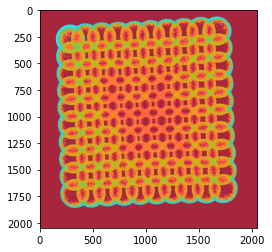

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


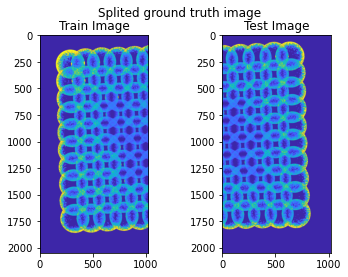

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


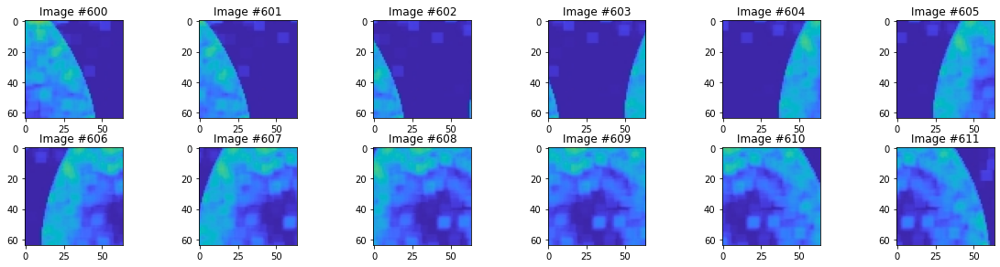

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


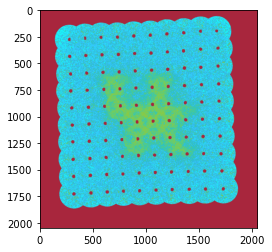

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


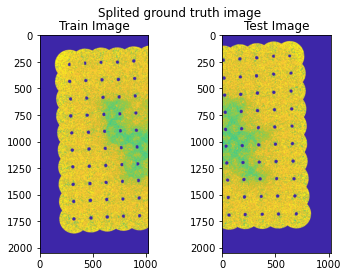

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


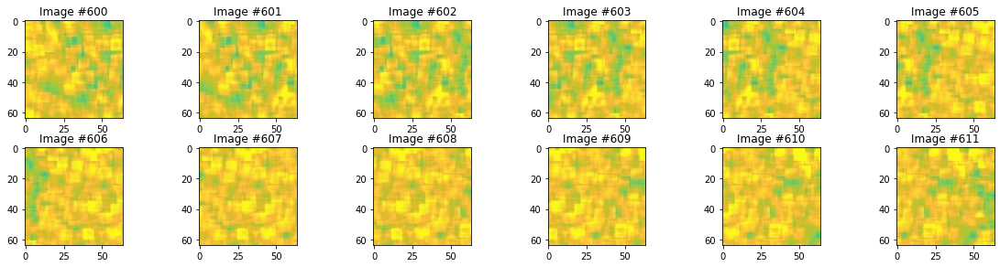

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


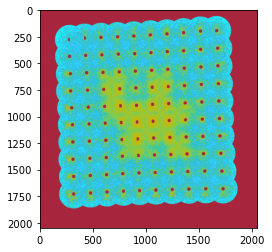

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


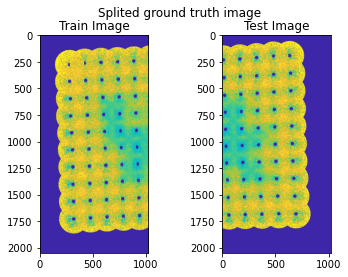

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


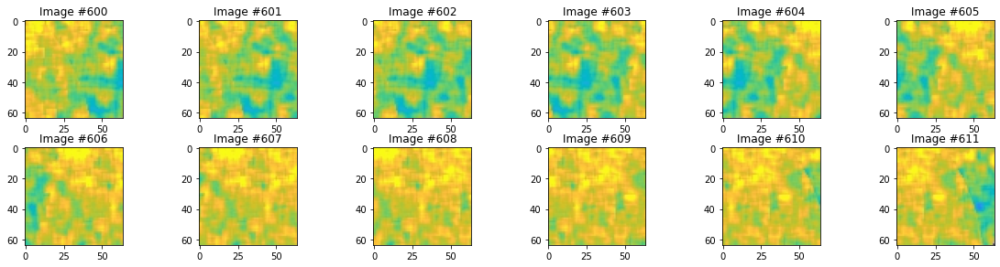

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


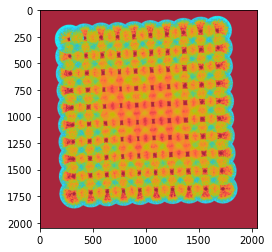

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


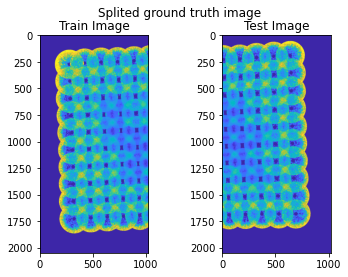

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


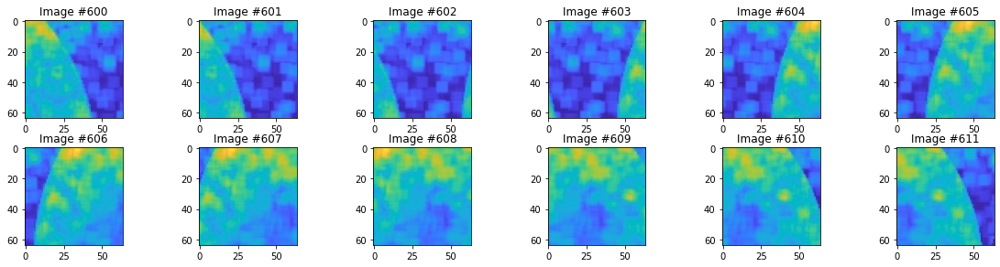

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_10sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


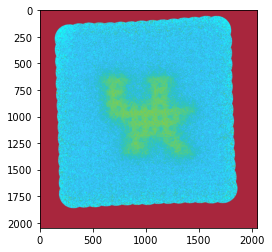

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


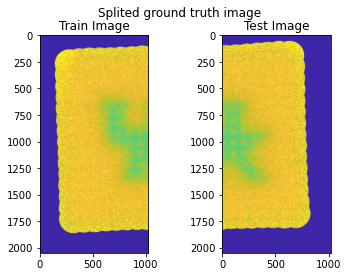

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


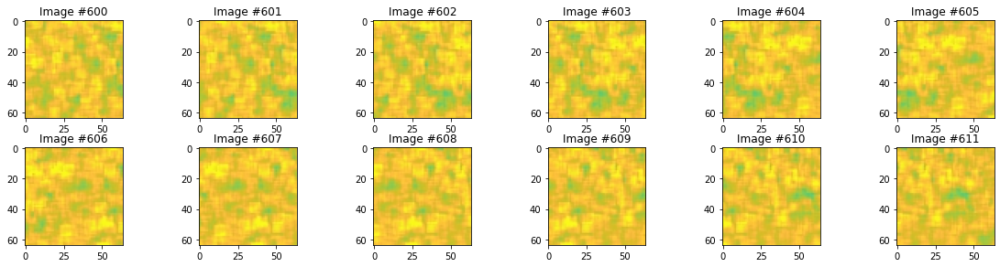

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


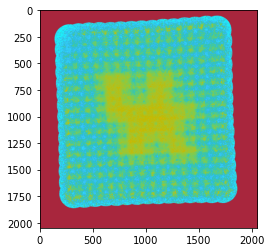

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


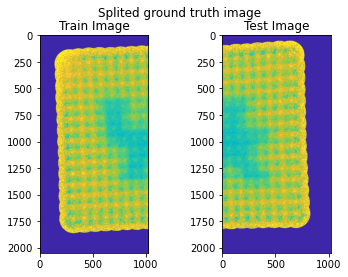

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


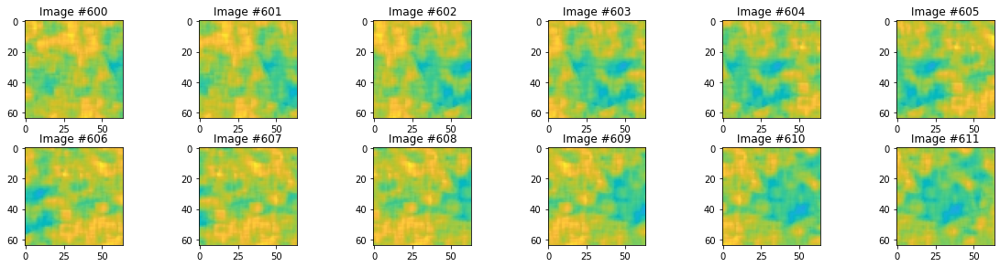

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


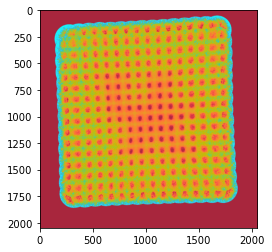

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


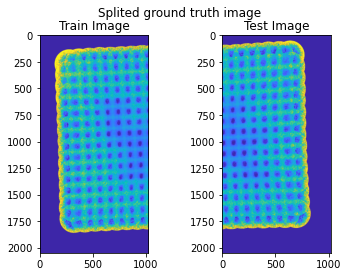

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


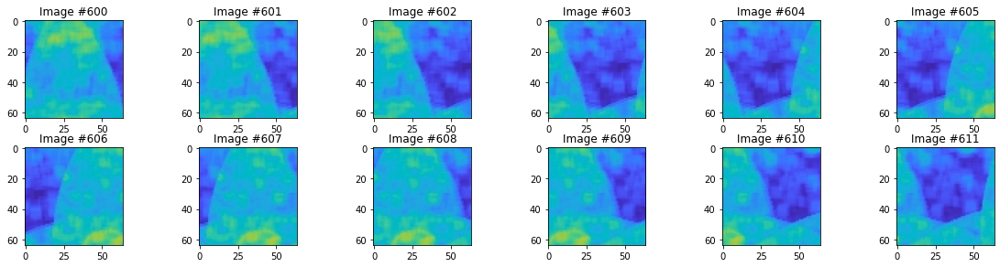

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


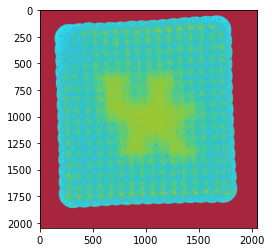

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


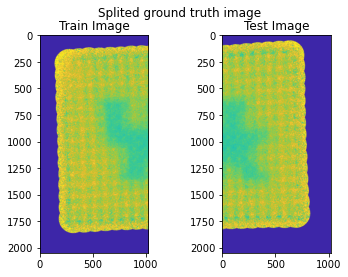

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


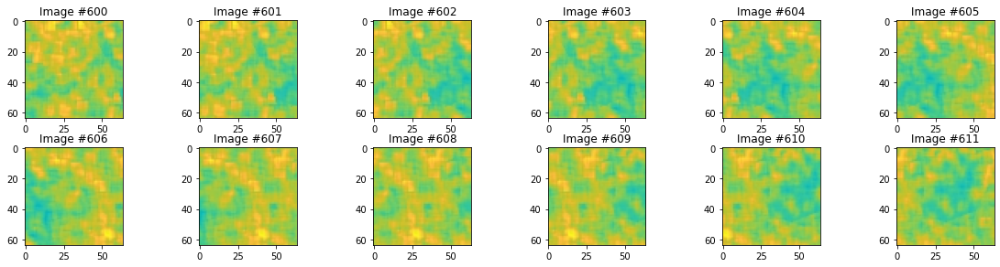

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


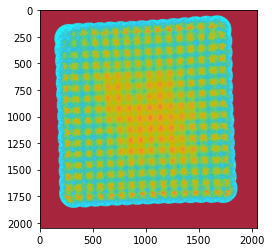

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


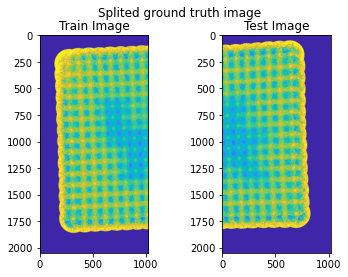

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


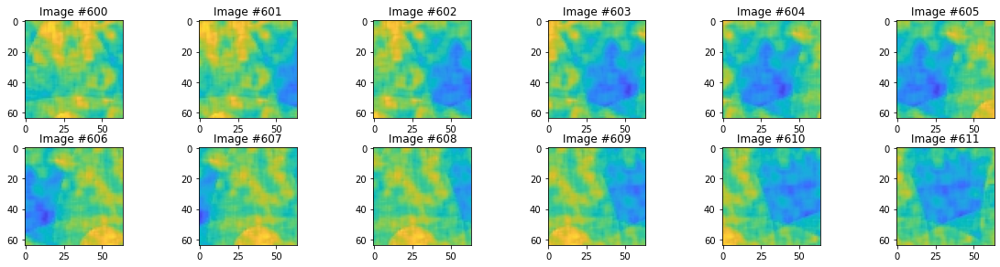

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


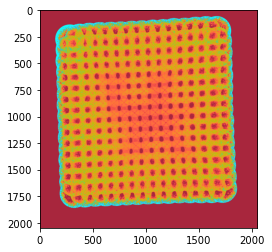

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


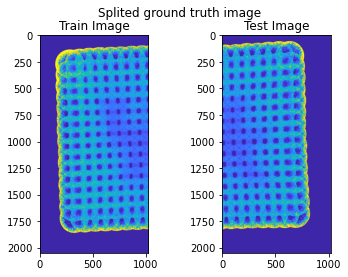

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


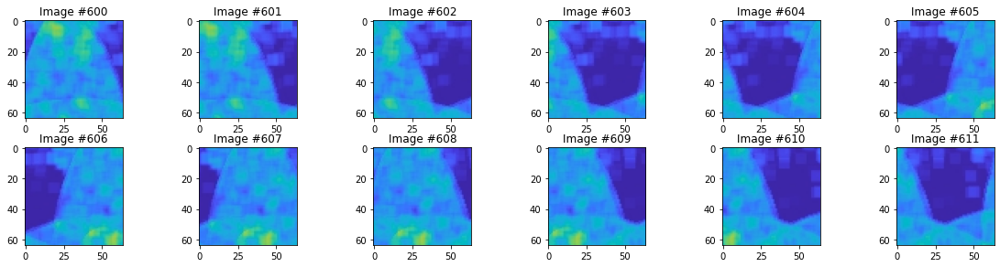

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


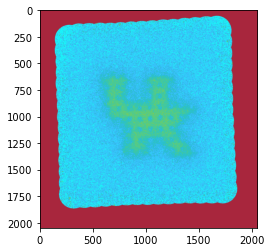

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


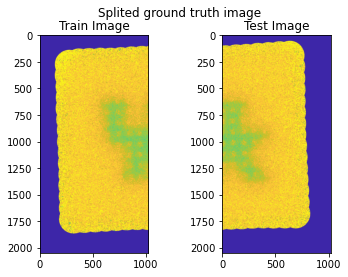

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


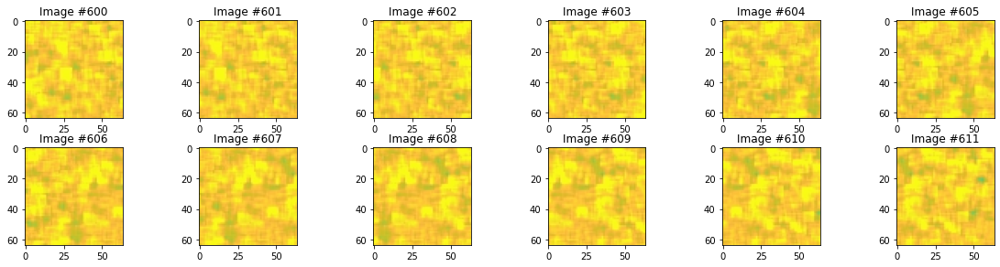

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


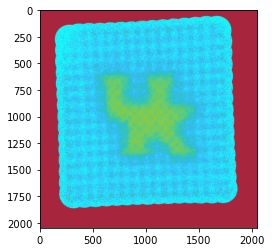

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


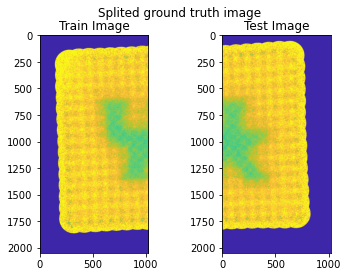

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


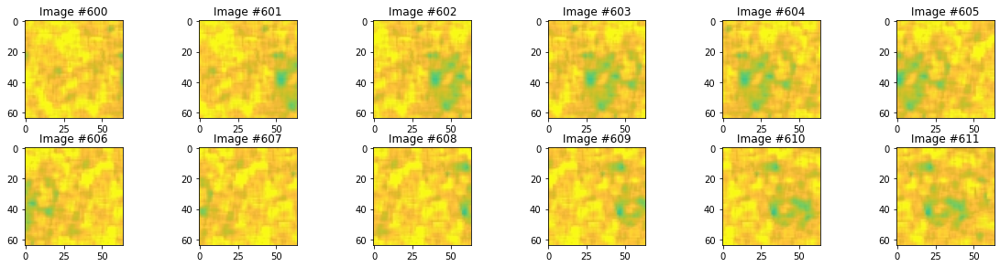

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


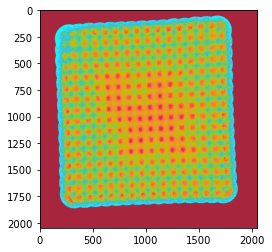

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


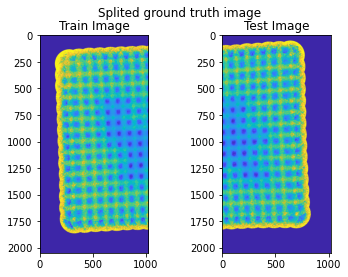

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


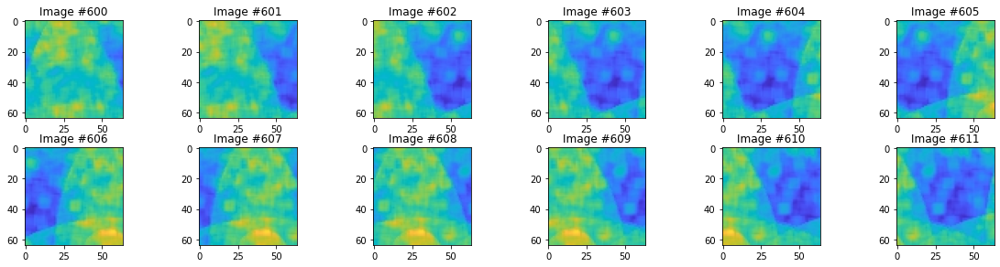

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_15sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


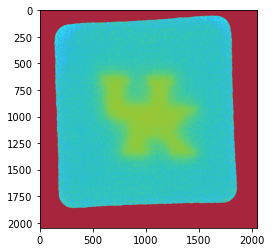

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


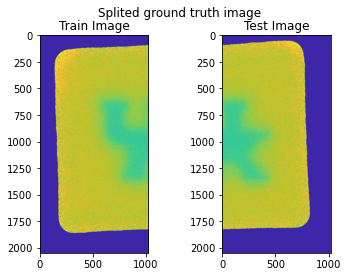

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


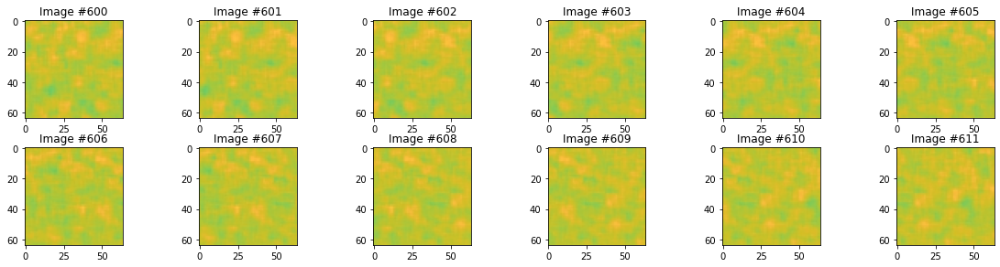

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


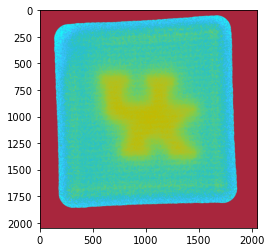

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


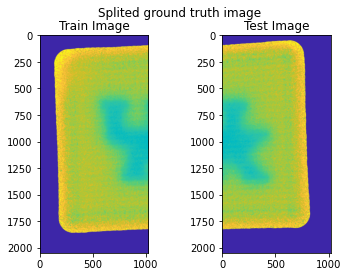

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


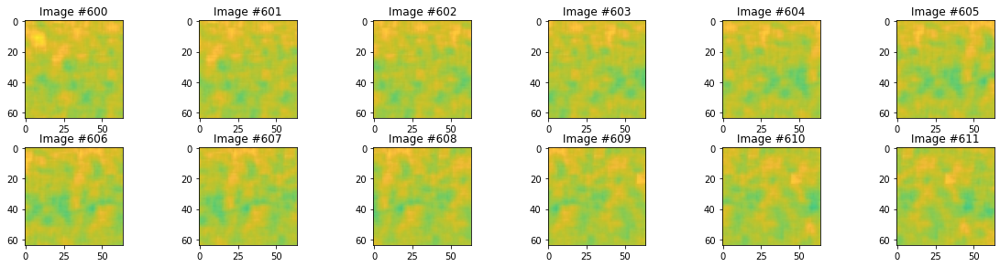

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


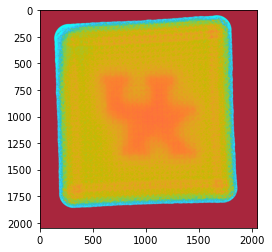

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


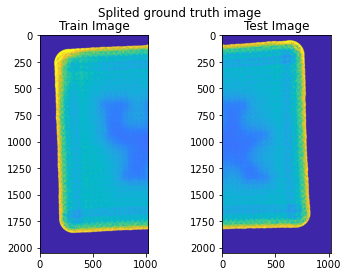

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


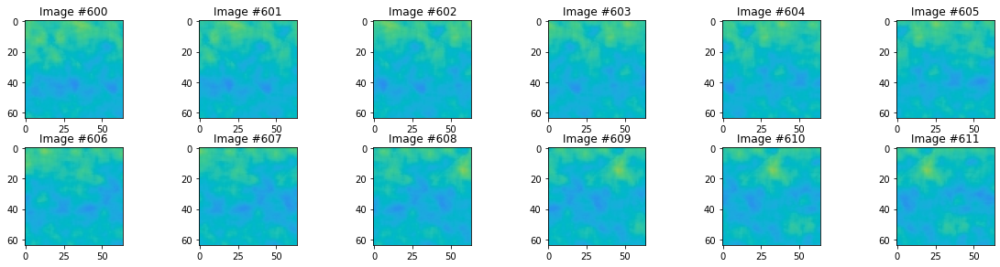

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


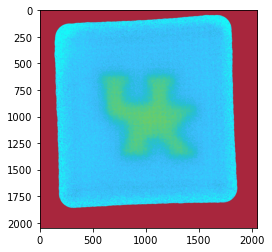

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


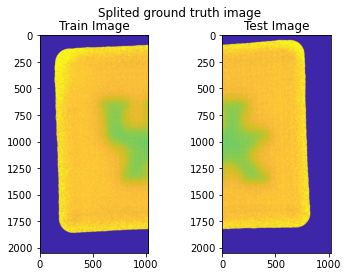

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


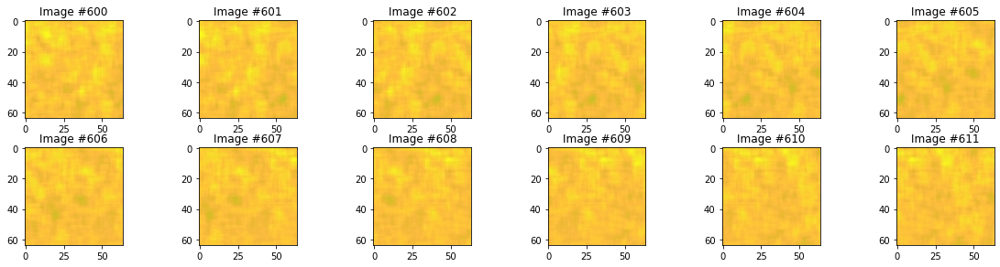

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


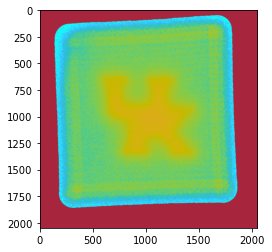

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


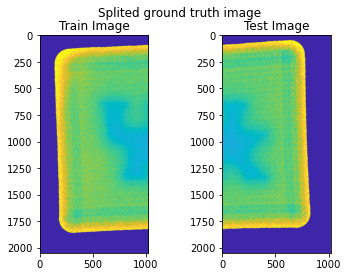

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


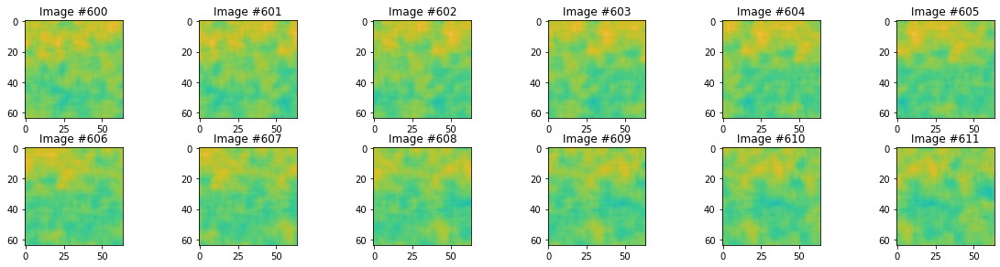

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


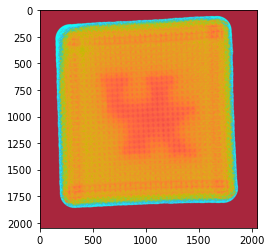

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


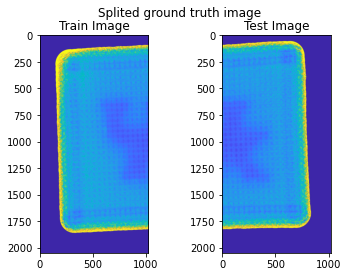

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


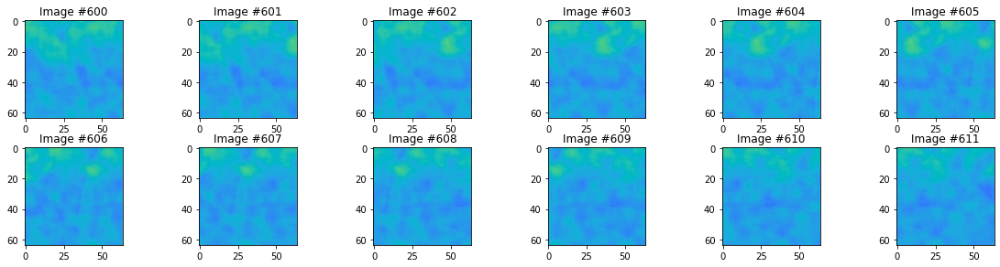

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


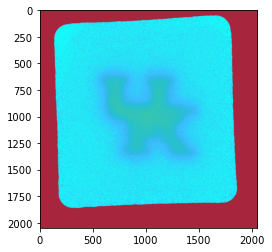

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


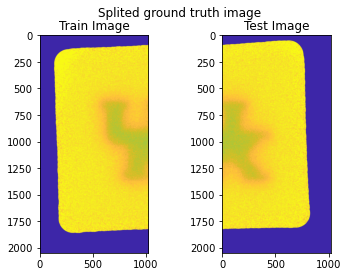

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


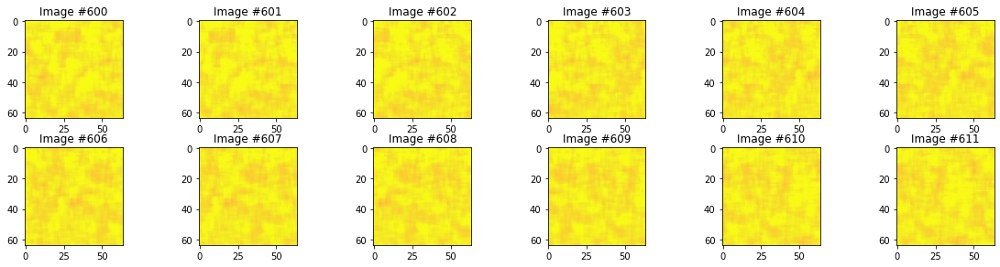

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


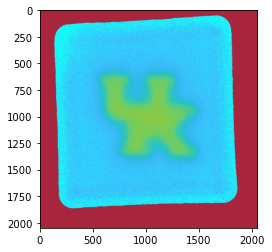

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


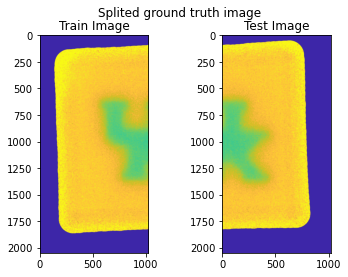

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


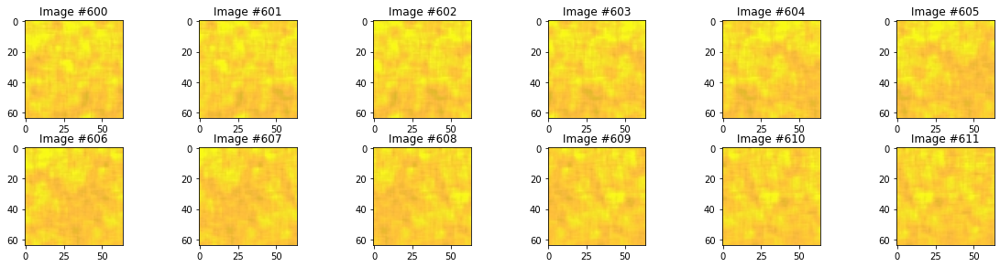

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


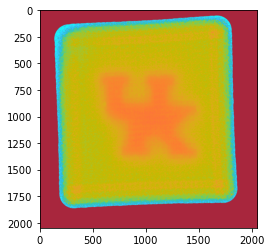

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


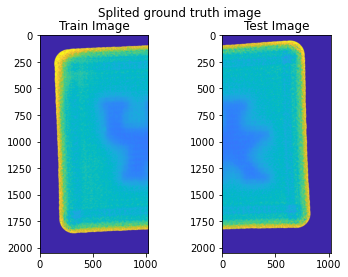

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


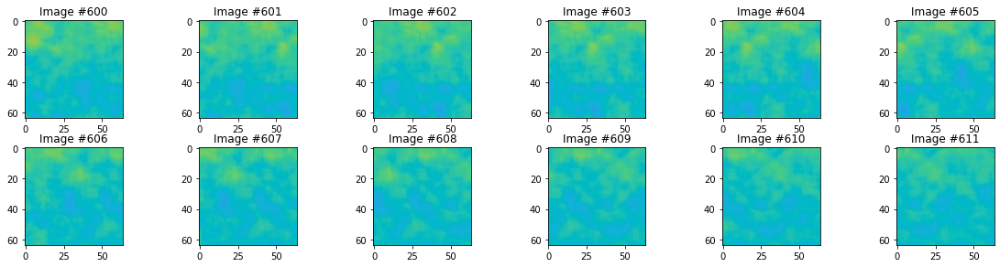

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\1mm_30sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


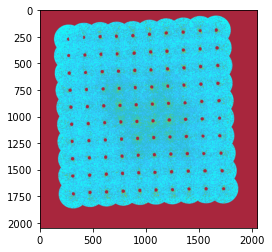

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


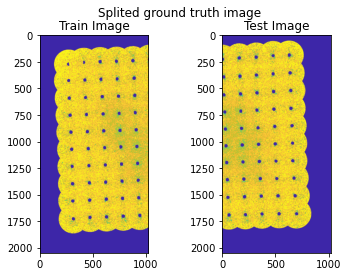

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


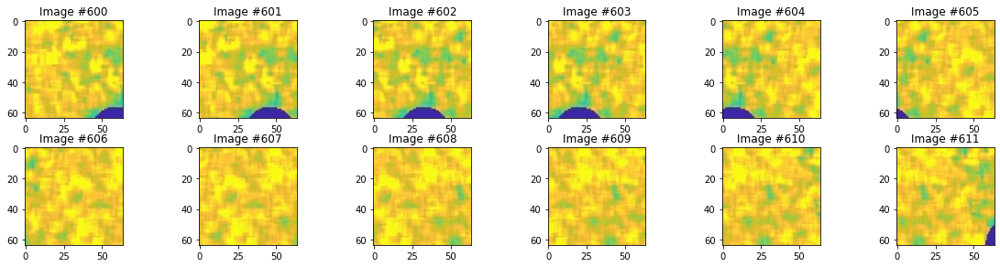

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


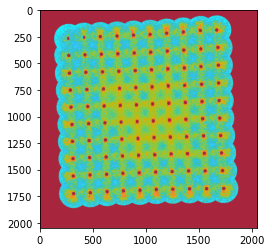

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


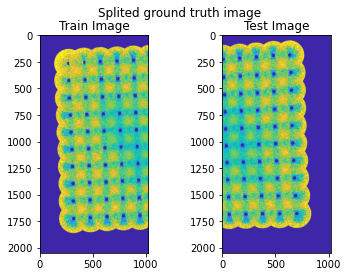

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


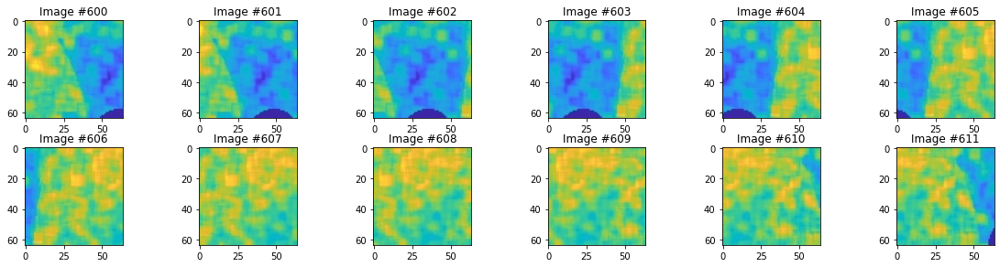

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


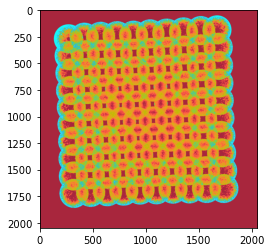

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


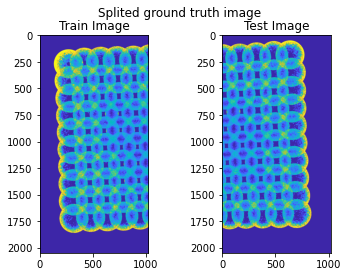

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


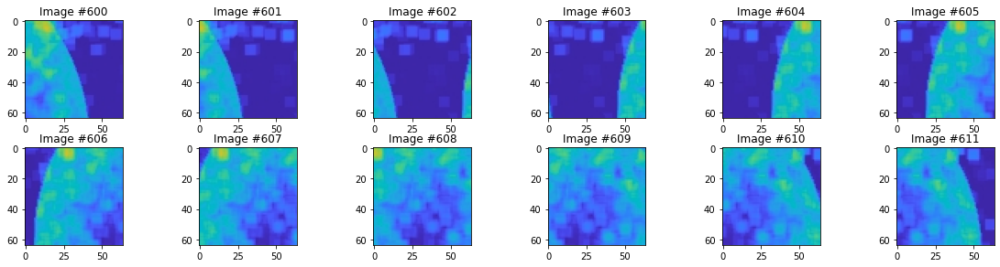

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


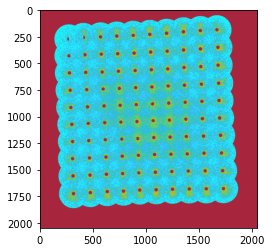

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


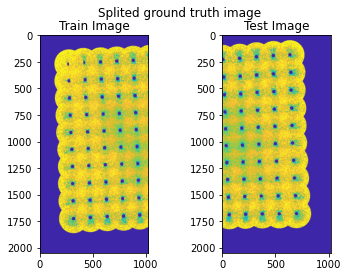

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


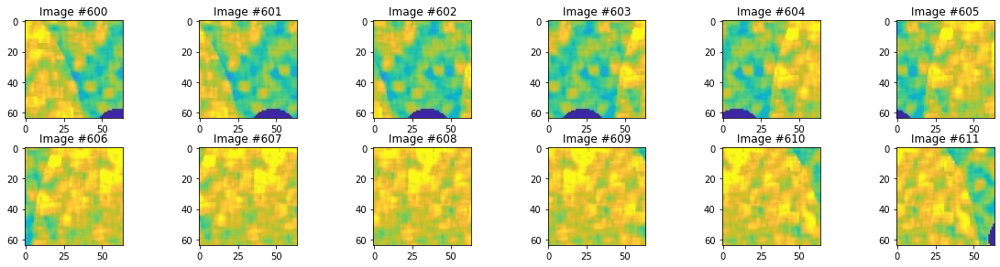

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


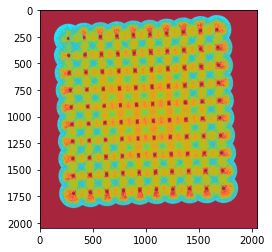

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


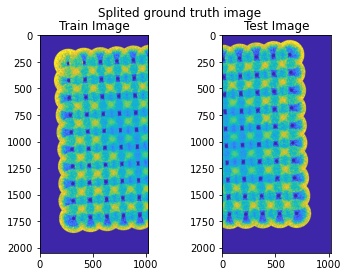

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


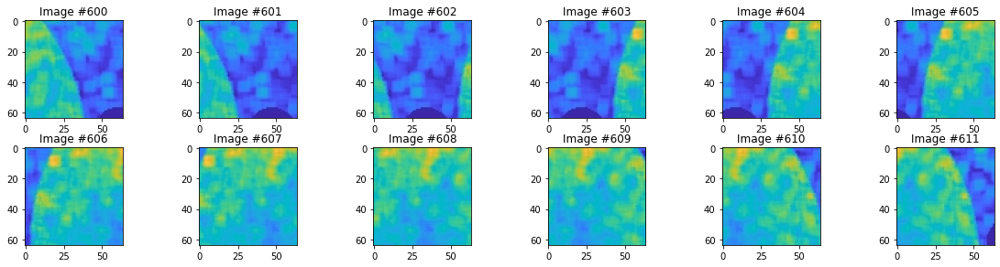

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


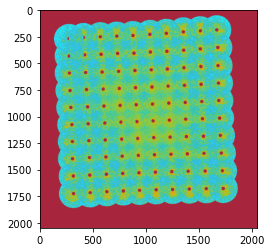

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


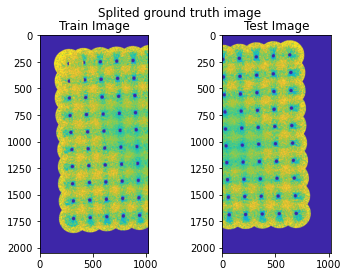

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


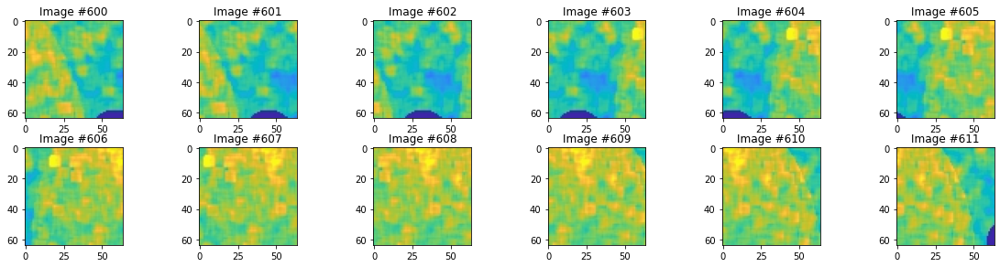

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


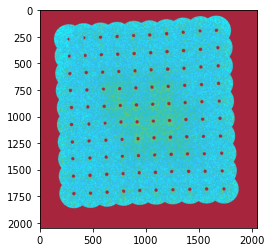

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


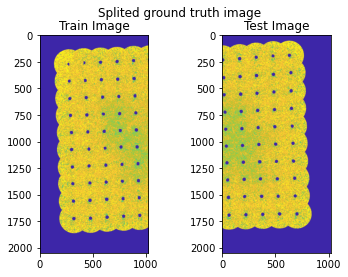

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


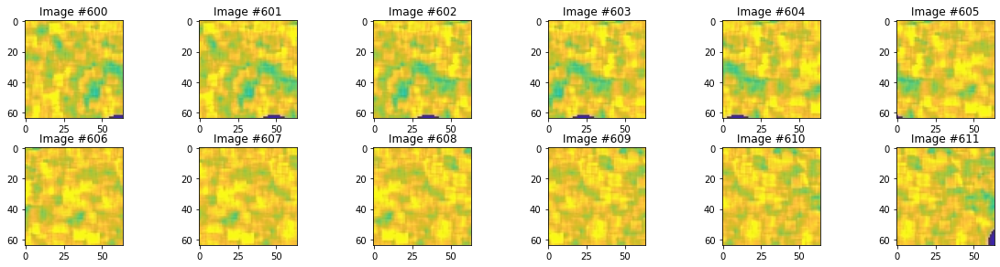

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


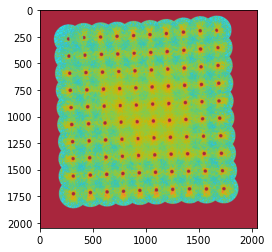

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


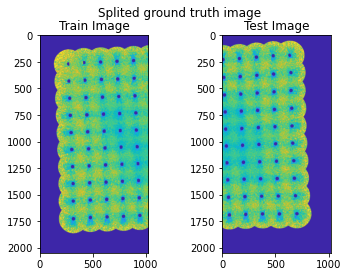

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


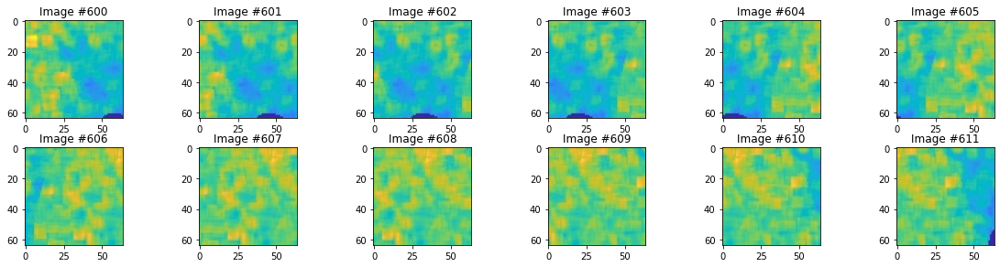

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


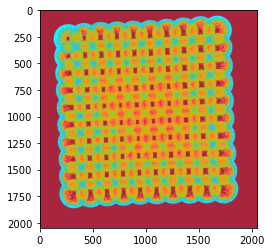

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


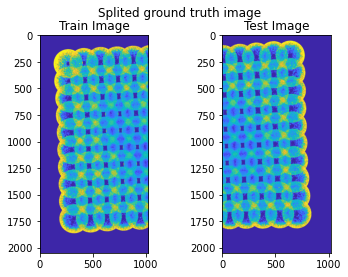

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


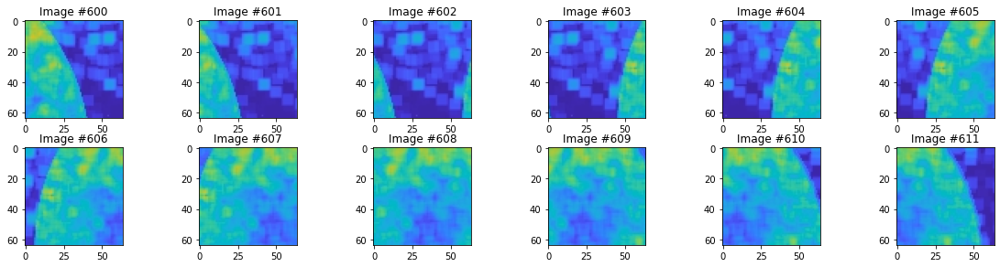

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_10sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


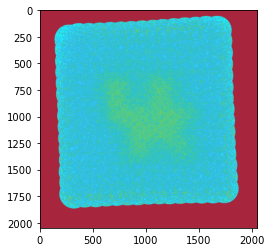

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


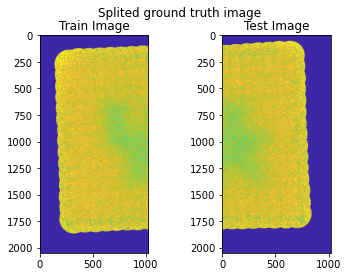

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


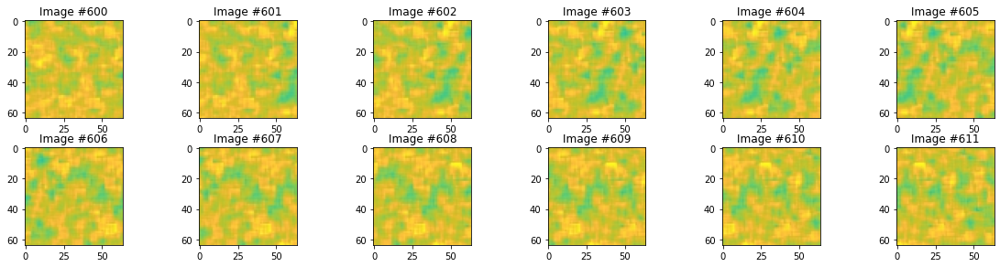

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


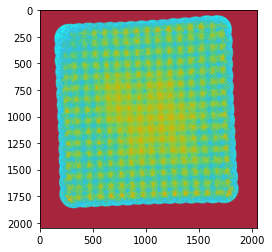

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


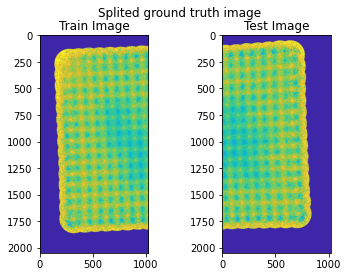

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


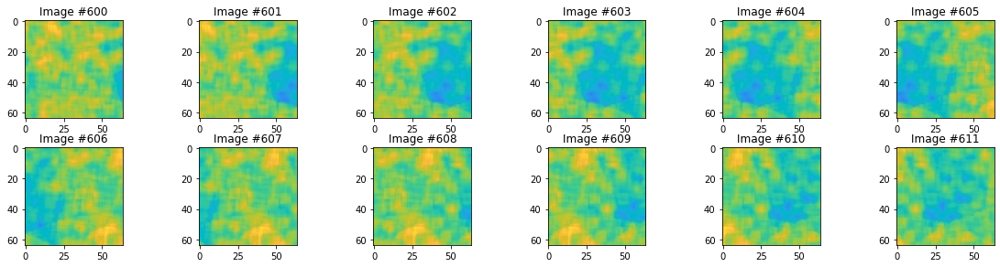

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


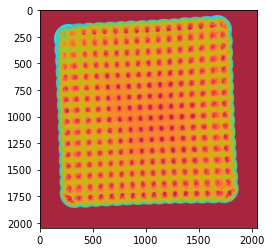

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


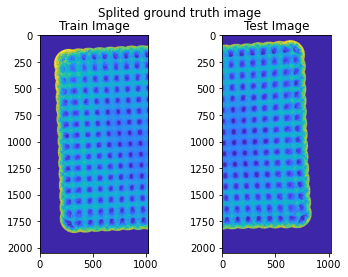

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


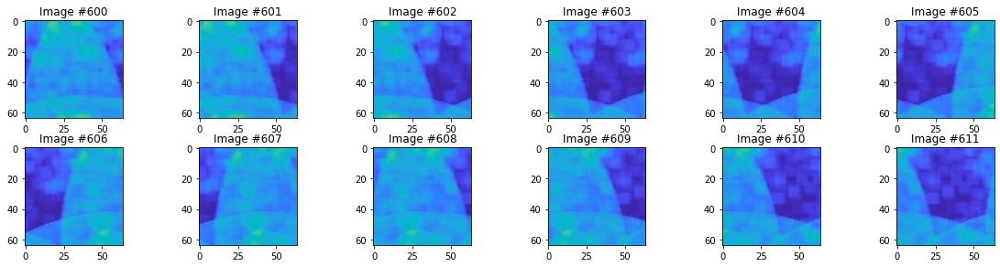

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


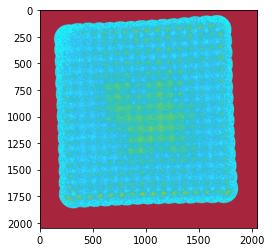

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


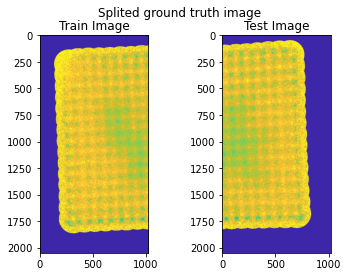

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


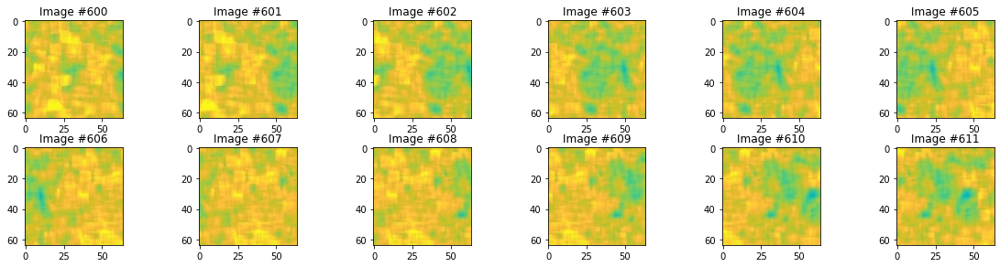

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


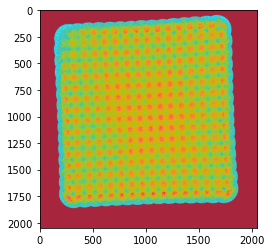

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


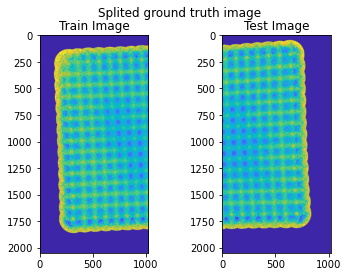

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


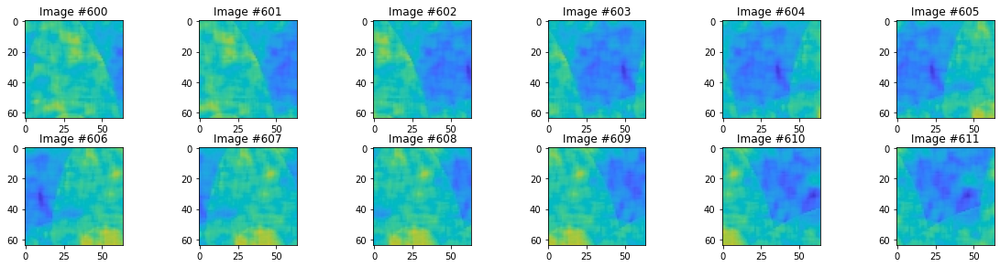

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


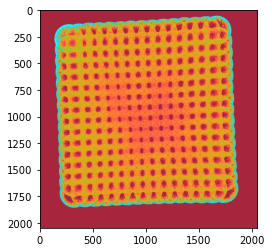

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


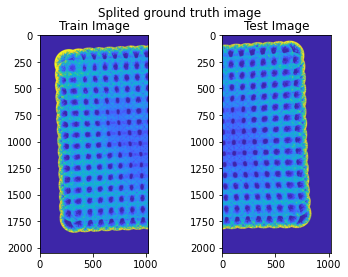

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


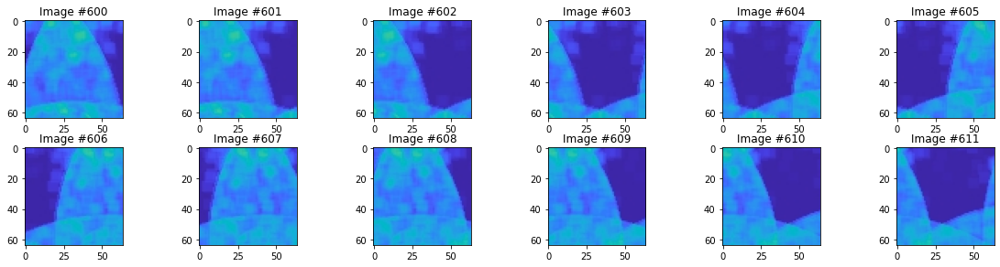

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


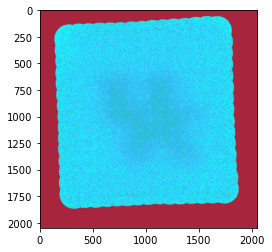

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


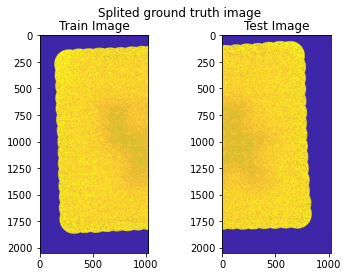

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


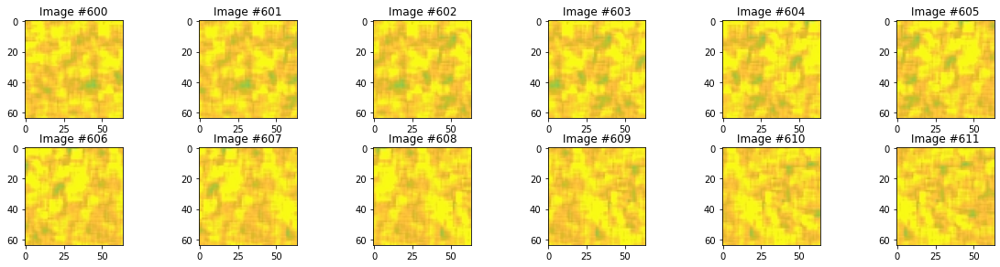

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


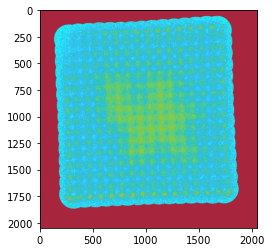

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


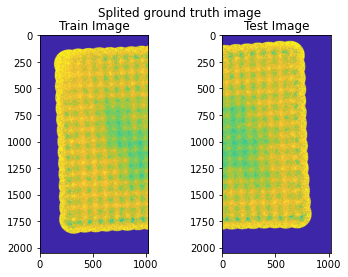

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


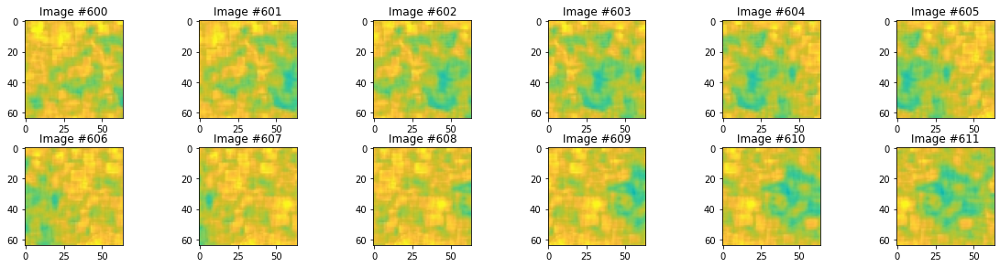

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


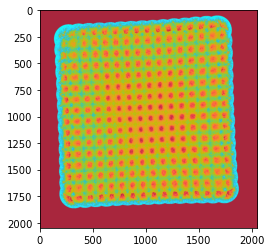

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


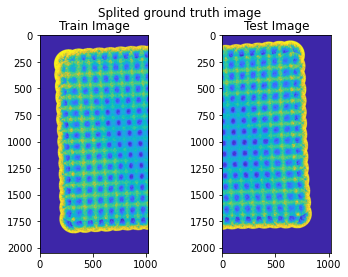

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


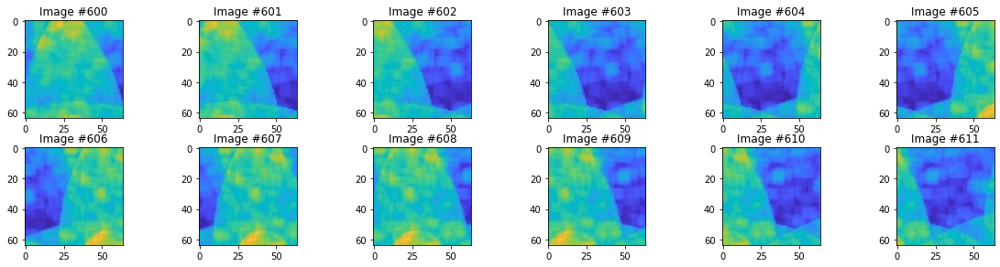

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_15sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


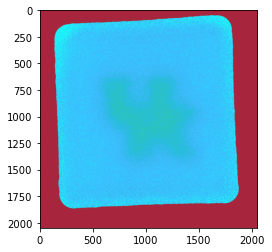

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


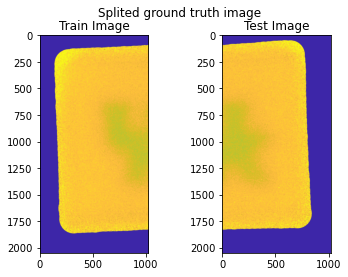

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


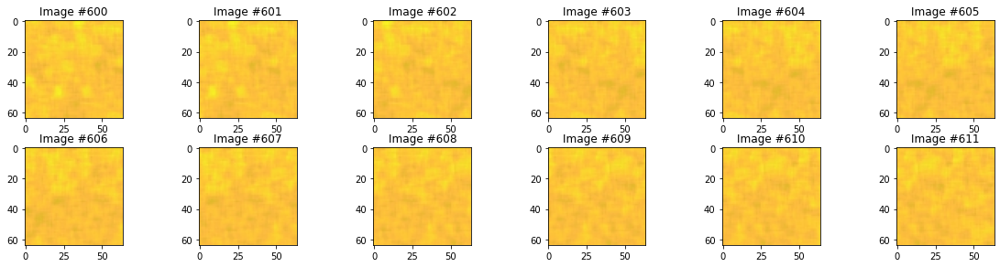

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


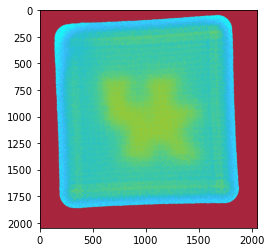

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


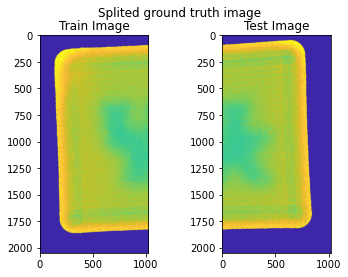

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


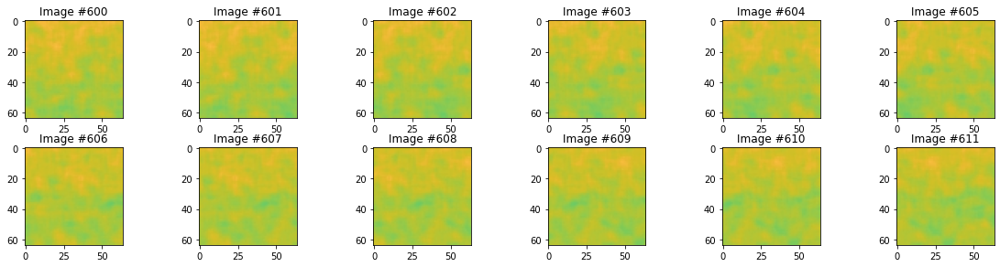

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


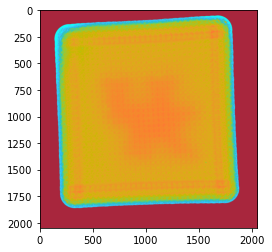

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


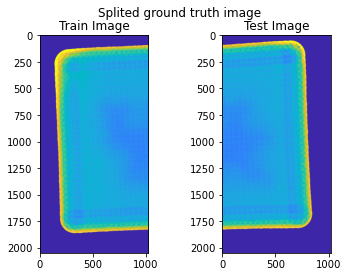

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


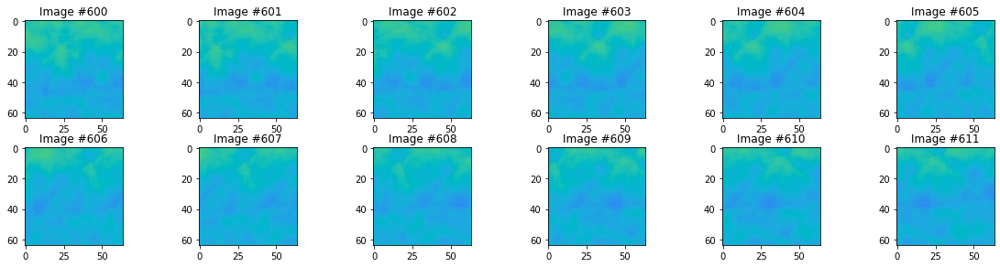

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


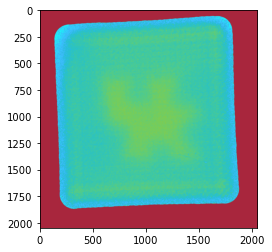

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


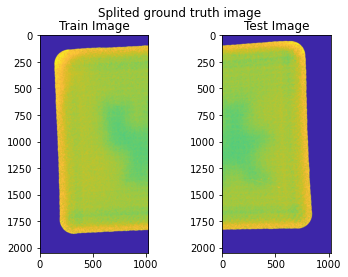

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


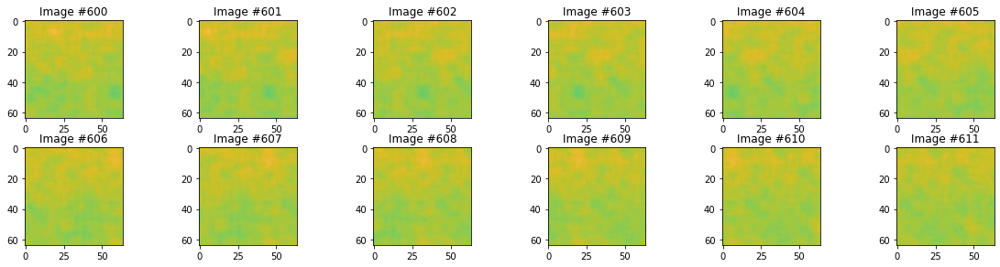

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


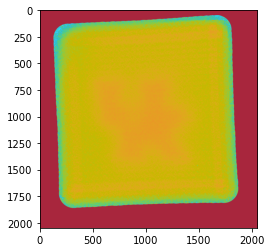

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


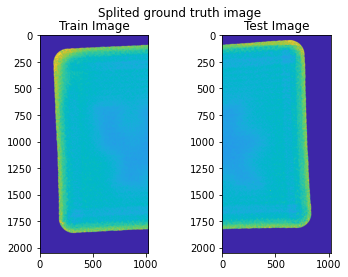

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


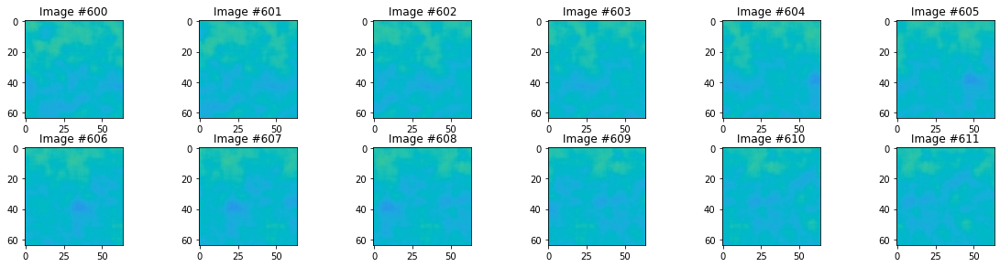

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


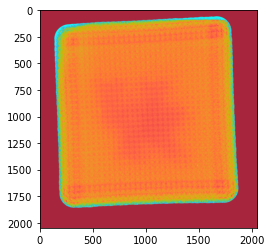

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


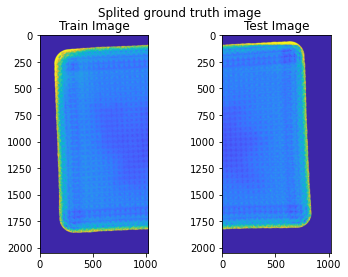

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


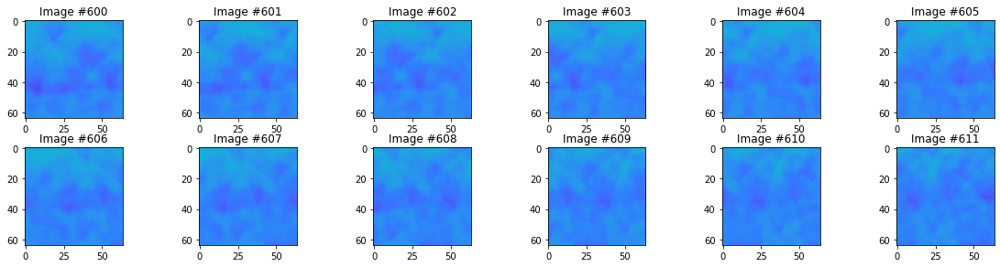

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


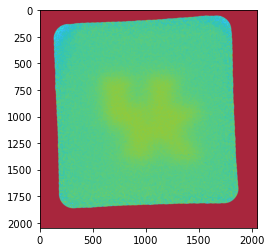

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


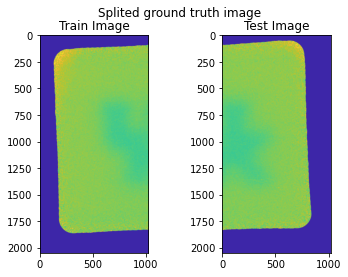

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


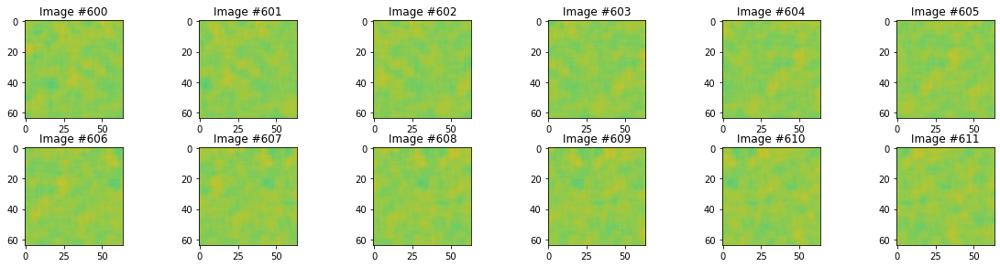

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


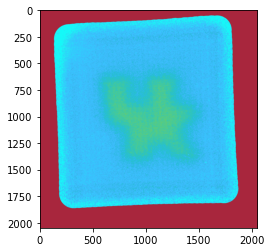

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


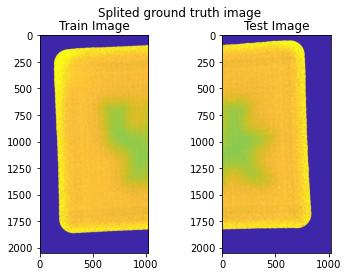

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


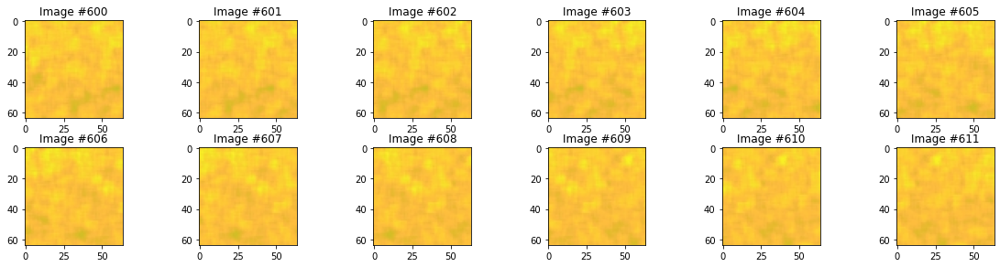

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


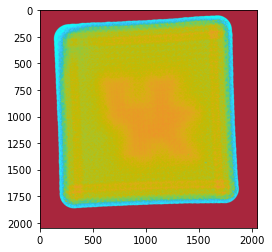

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


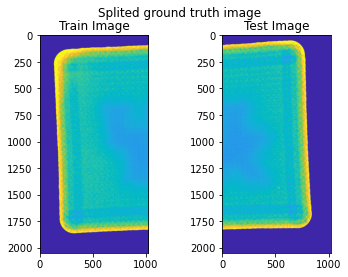

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


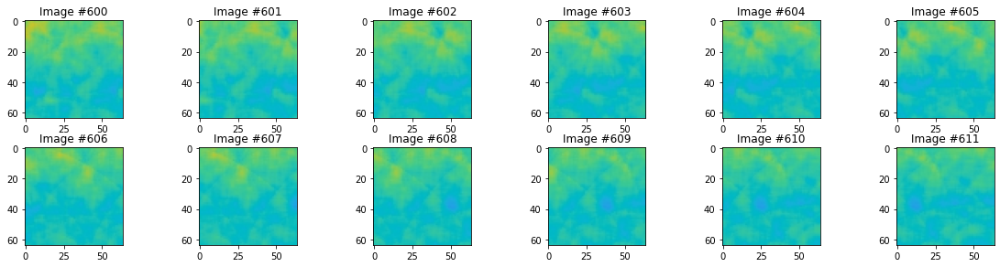

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\2mm_30sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


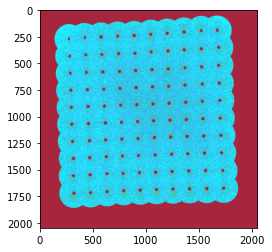

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


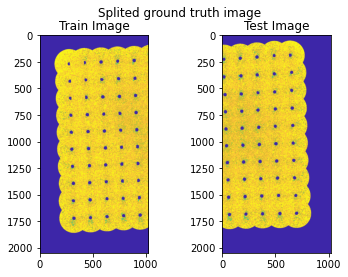

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


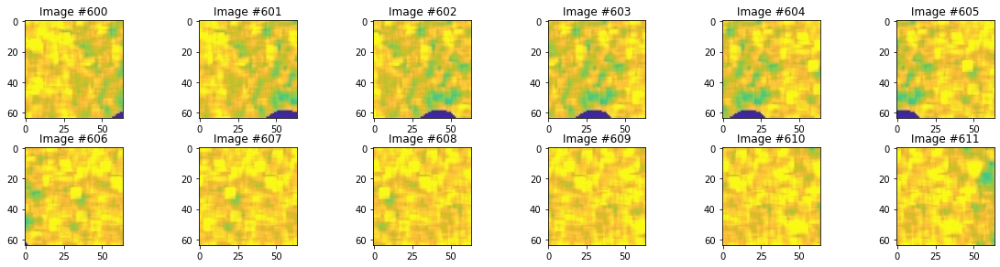

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


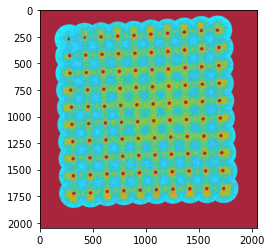

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


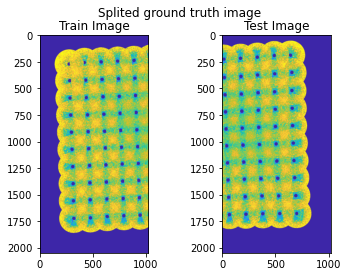

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


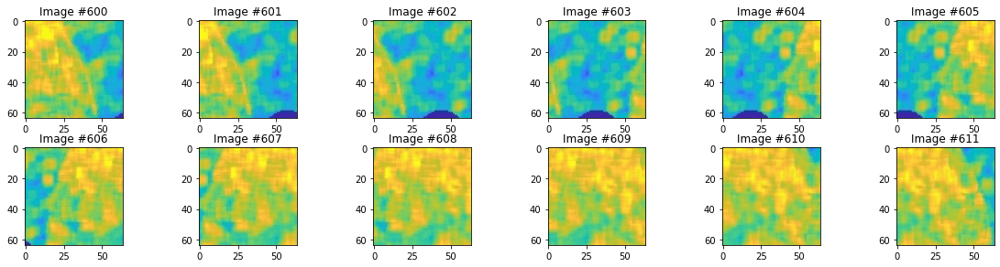

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


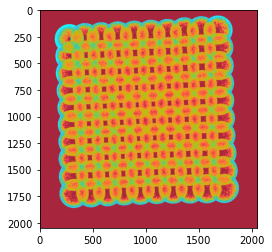

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


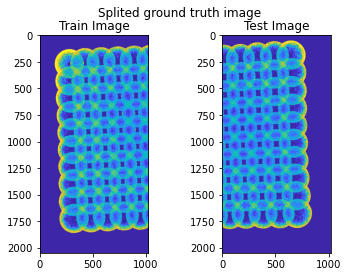

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


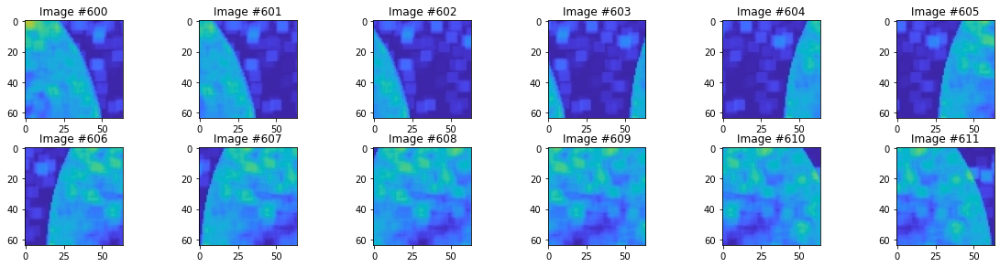

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


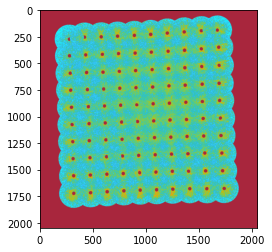

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


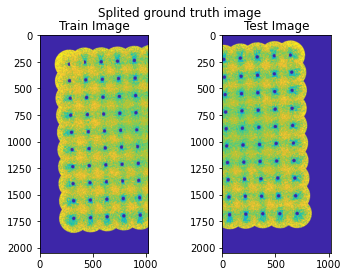

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


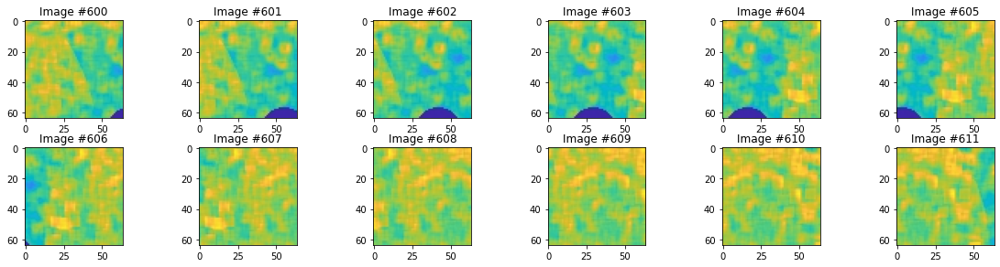

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


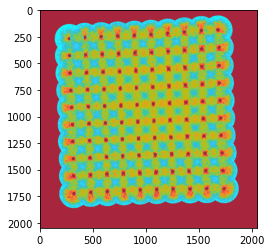

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


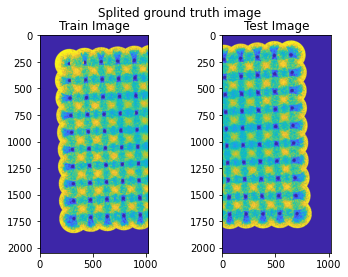

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


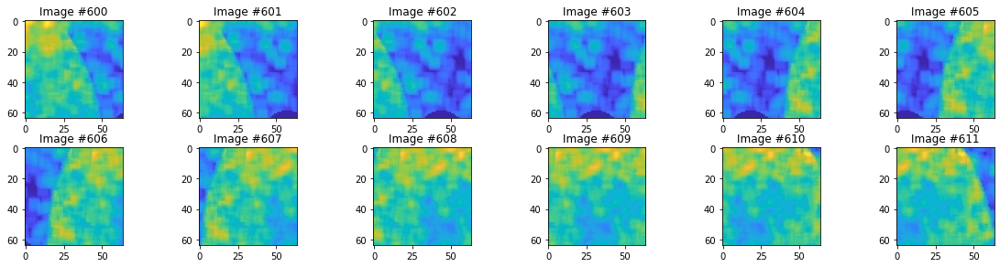

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


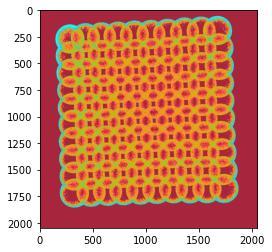

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


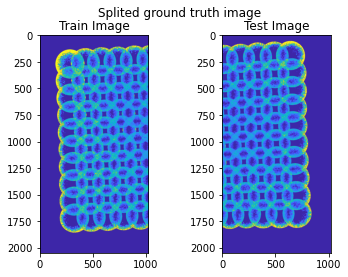

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


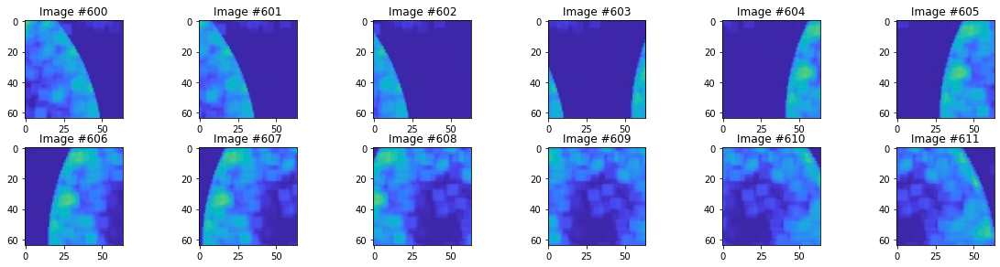

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


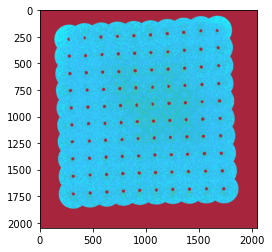

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


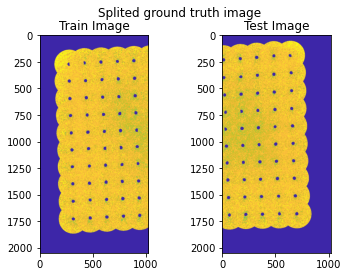

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


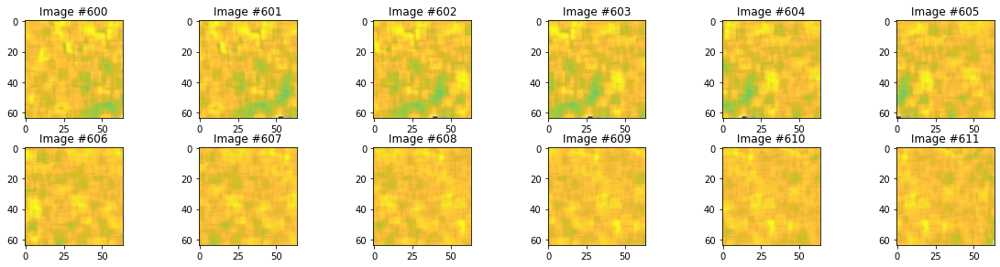

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


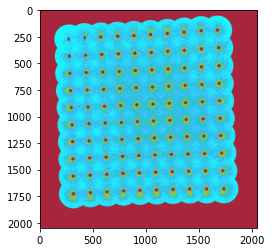

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


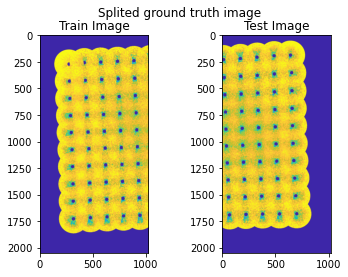

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


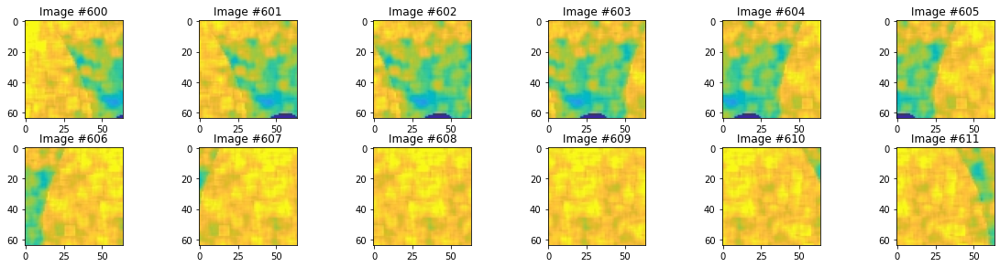

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


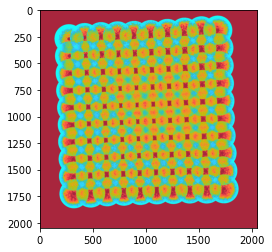

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


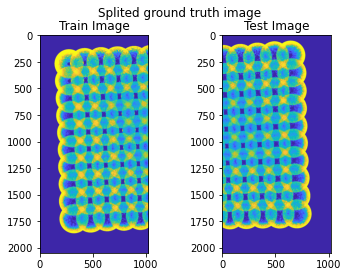

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


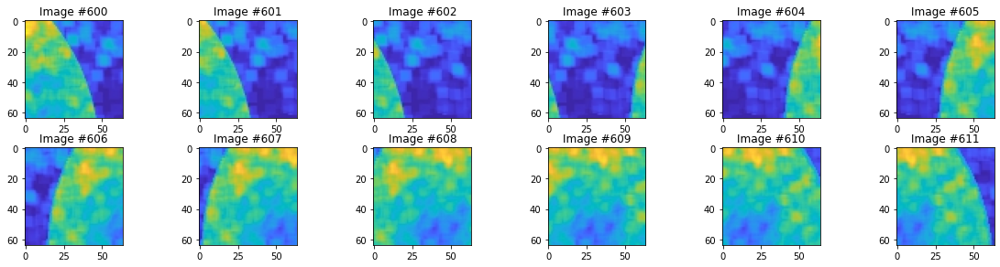

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_10sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


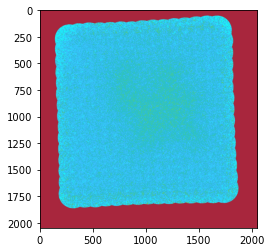

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


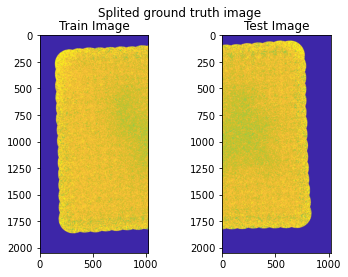

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


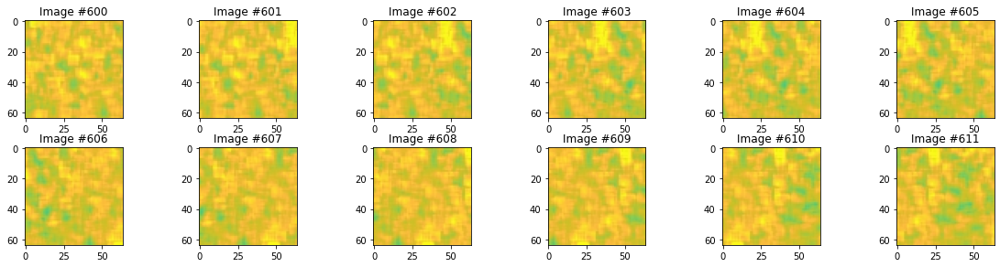

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


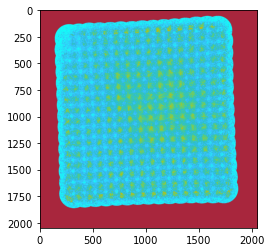

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


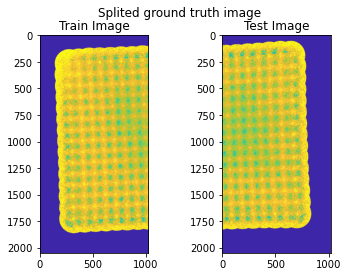

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


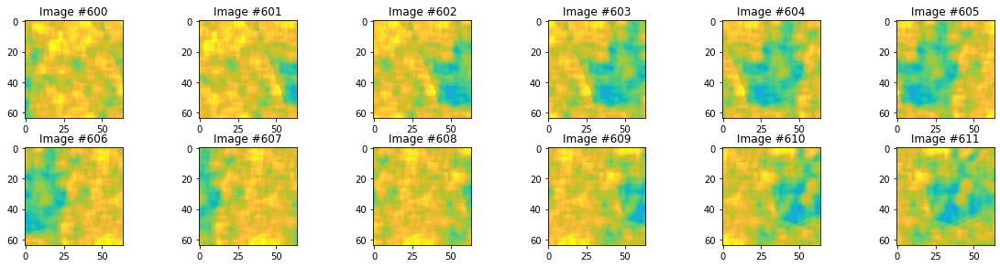

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


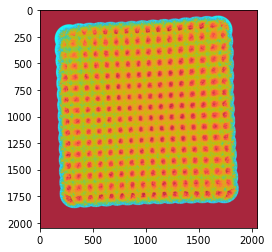

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


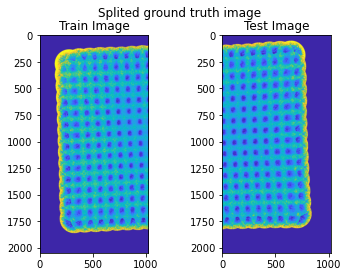

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


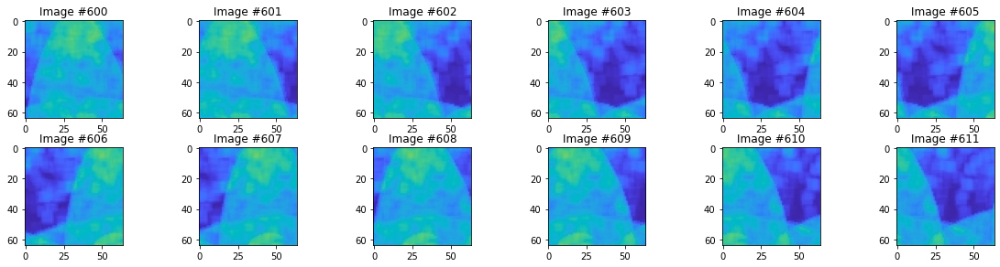

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


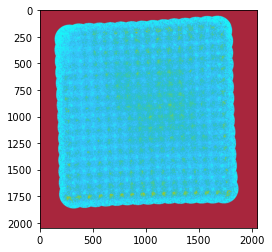

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


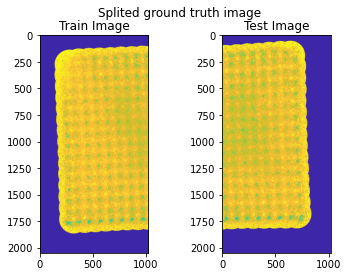

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


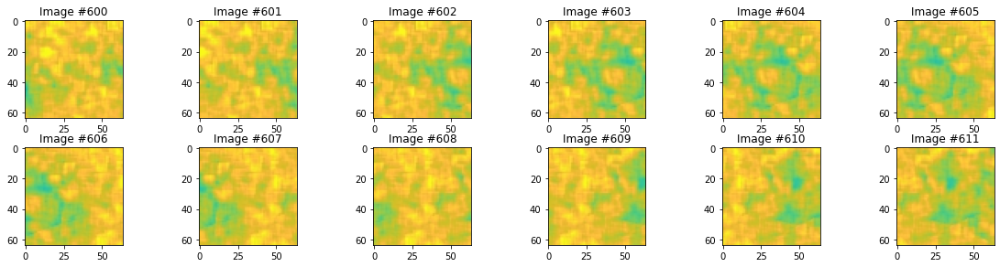

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


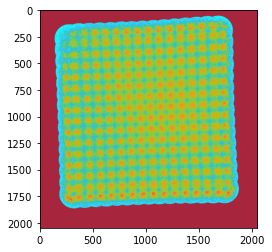

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


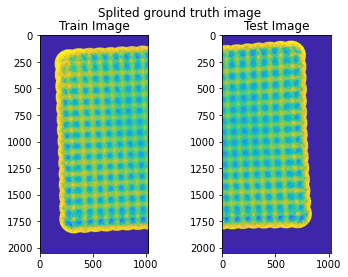

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


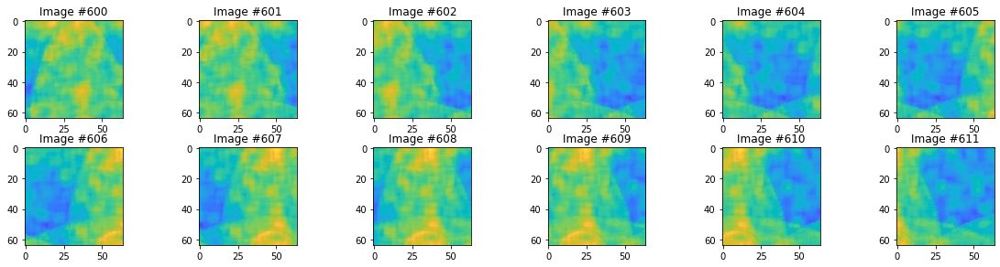

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


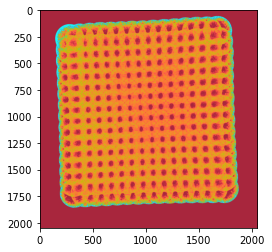

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


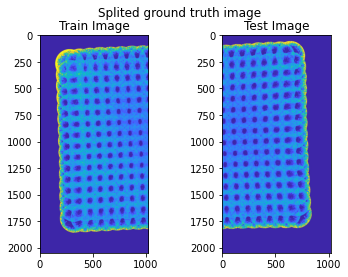

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


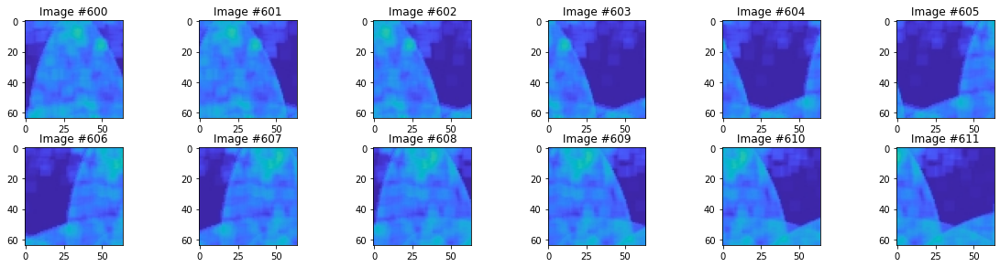

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


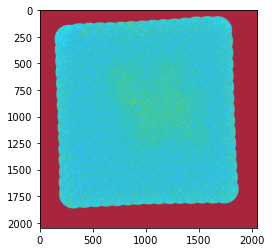

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


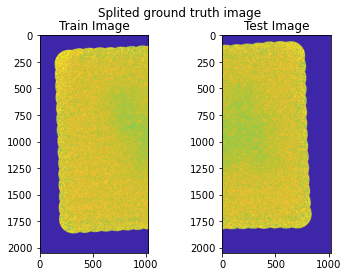

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


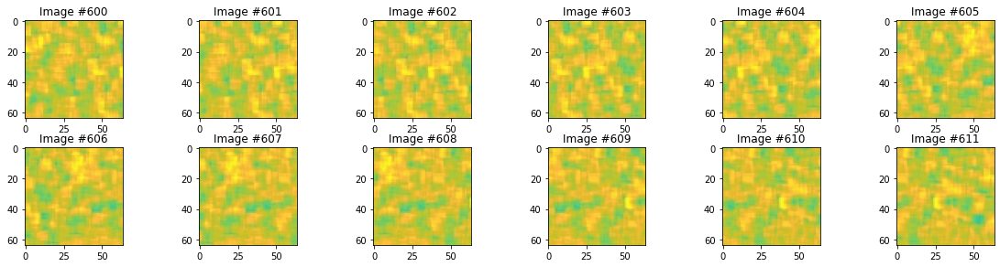

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


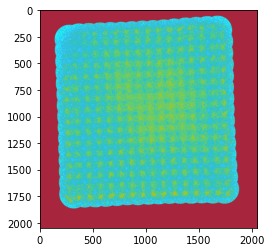

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


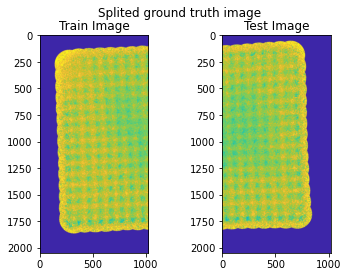

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


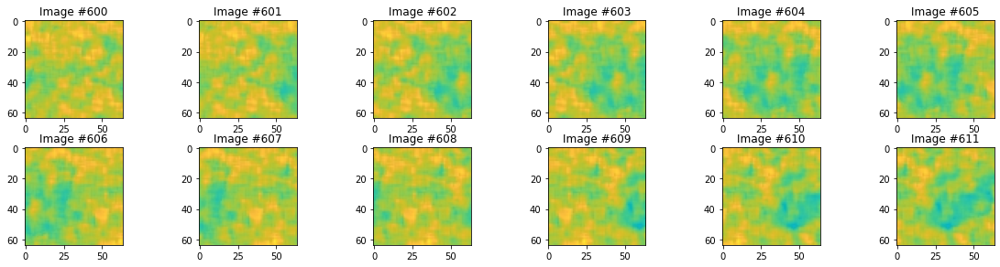

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


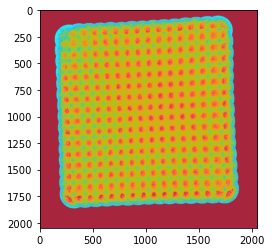

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


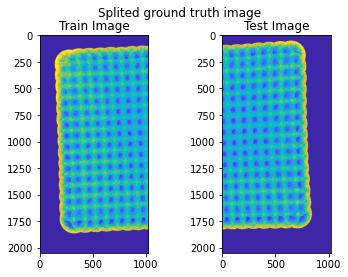

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


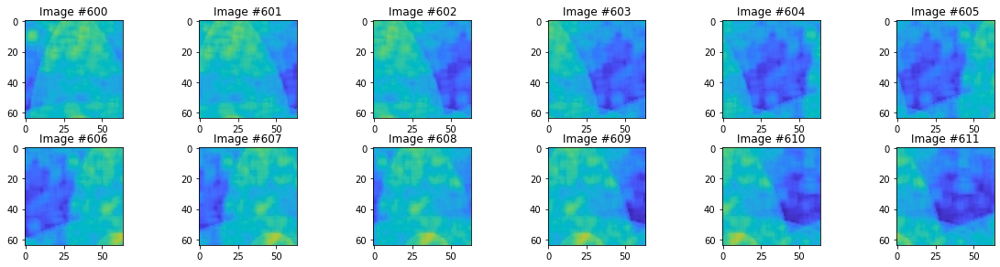

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_15sources_80mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


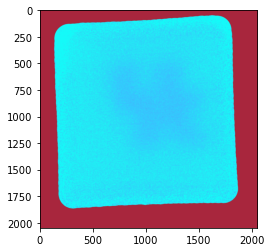

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


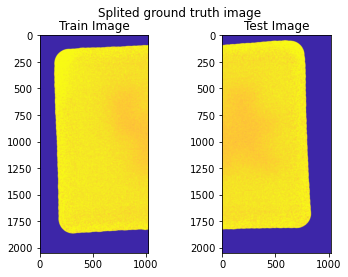

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


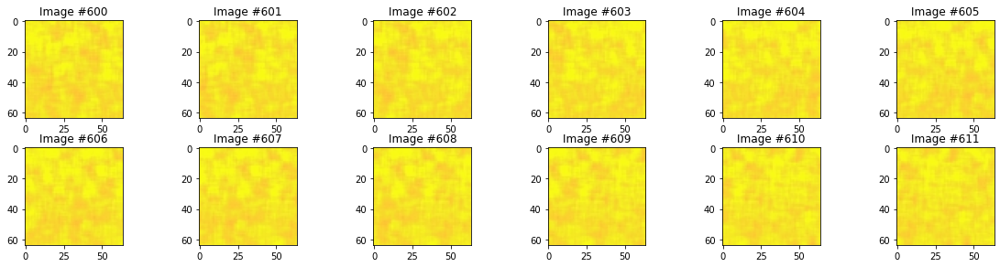

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


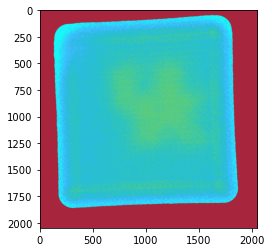

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


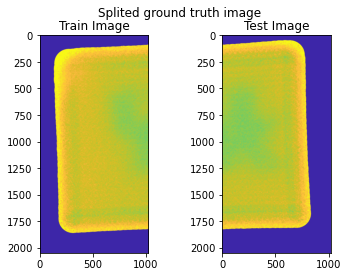

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


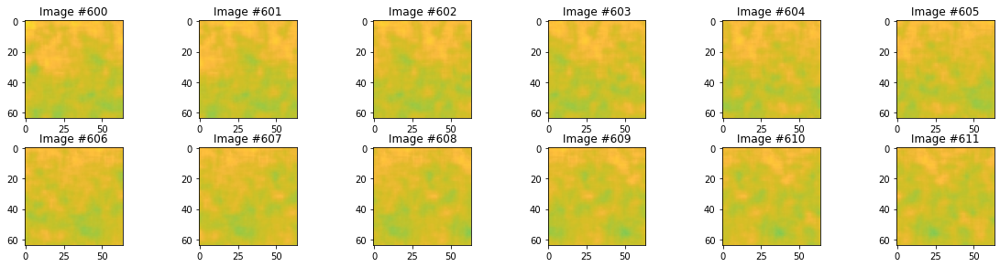

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


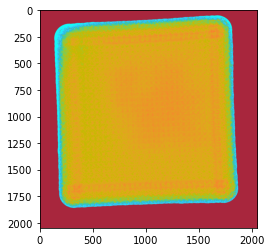

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


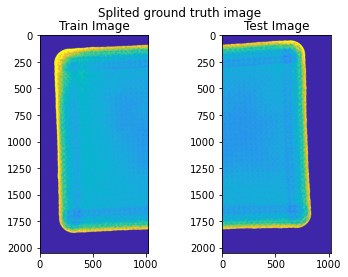

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


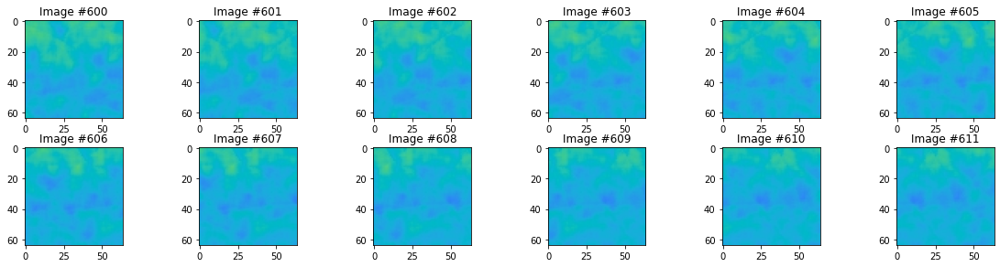

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_100mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


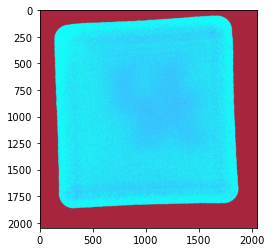

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


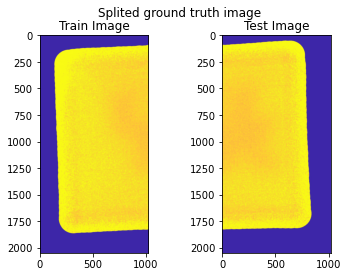

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


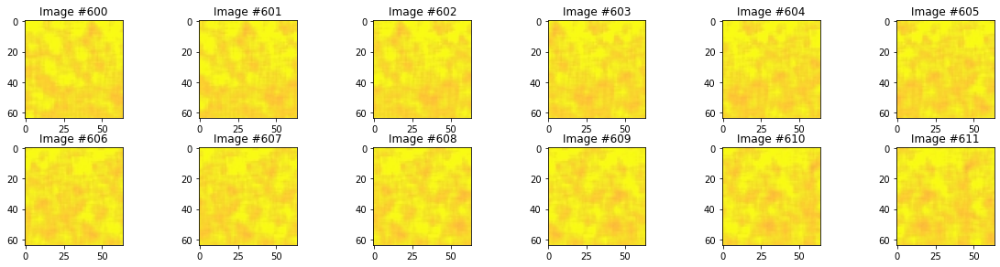

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


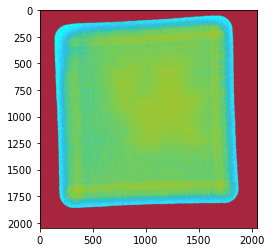

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


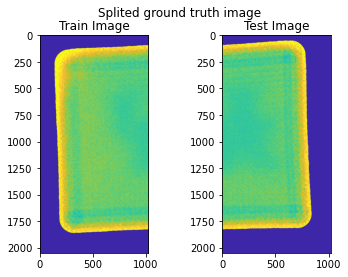

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


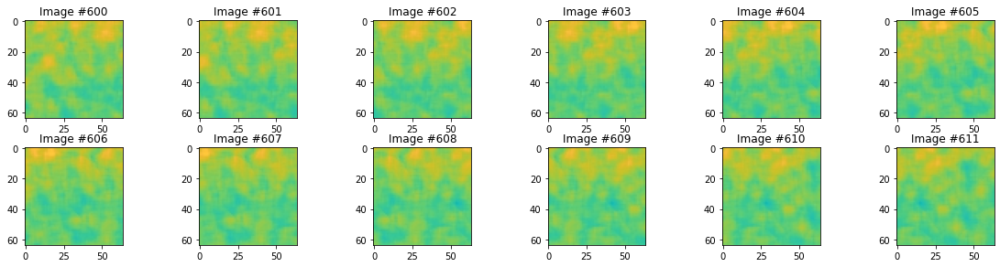

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


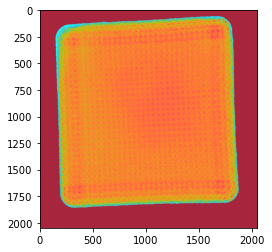

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


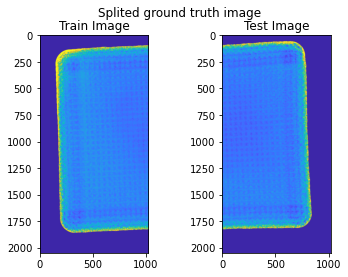

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


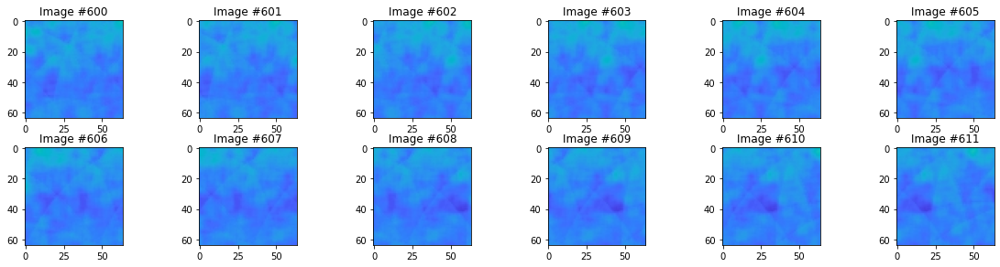

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_150mW_5ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


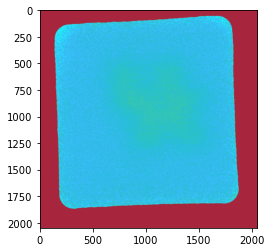

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


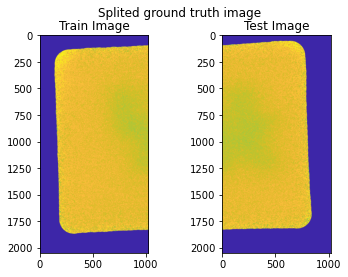

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


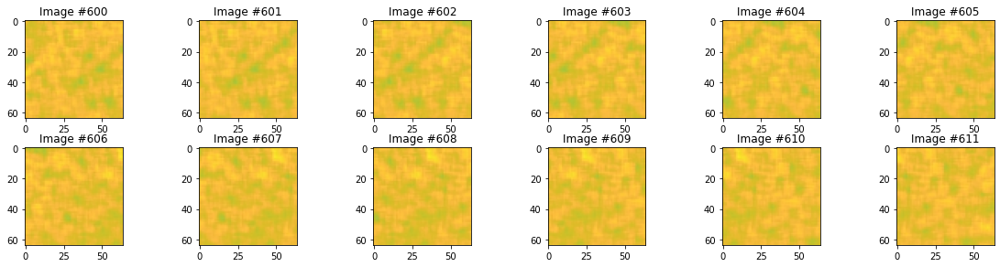

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_1ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_1ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_1ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


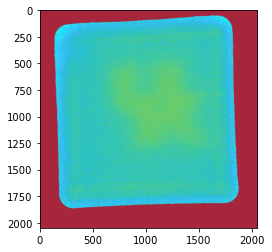

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


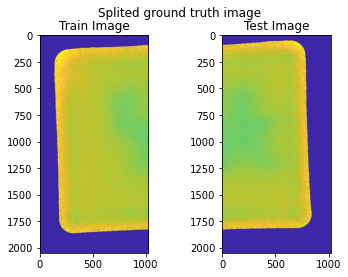

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


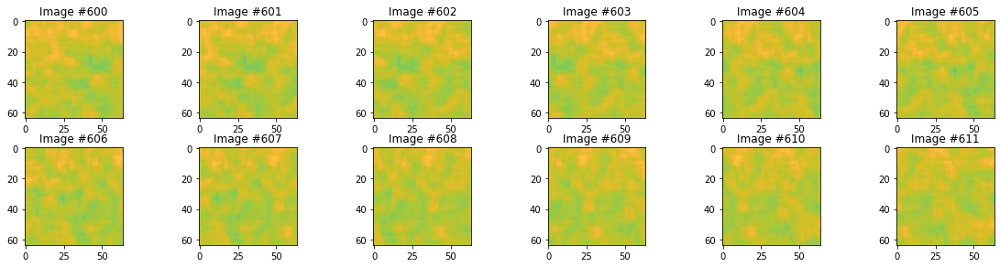

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_2ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_2ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_2ms_1\Splitted_Clipped_image\cars_train
Image type <class 'numpy.ndarray'>
Ground Truth image shape: (2048, 2048, 3)


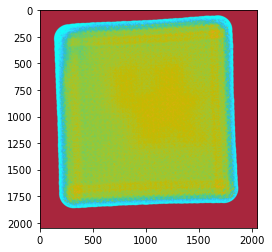

Test Shape: (2048, 1024, 3) Train Shape: (2048, 1024, 3)


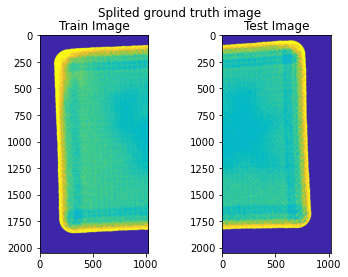

First test image shape (64, 64, 3)
First train image shape (64, 64, 3)
Images in test set: 8214
Images in train set: 8214
All test images have same shape: True
All train images have same shape: True
Length of train plus test set: 16428


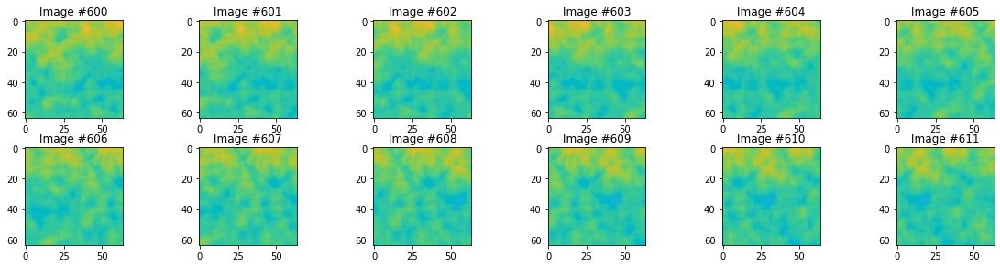

3608
True
Splitted_Clipped_image
directoryFullName: F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_5ms_1\Splitted_Clipped_image
testDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_5ms_1\Splitted_Clipped_image\cars_test
trainDirectory F:\2D_Imaging_UH3_Proposal\3mm_30sources_80mW_5ms_1\Splitted_Clipped_image\cars_train


In [2]:
for imageName in imageList:
    image = cv2.imread(imageName, cv2.IMREAD_COLOR)
    print('Image type',type(image))
    imageShape=image.shape
    print('Ground Truth image shape:',imageShape)
    plt.imshow(image)
    plt.show()
    
    # Dividing the image into two parts:
    
    imageTrain=image[:,:int(imageShape[1]/2),:]
    imageTest=image[:,int(imageShape[1]/2):,:]
    print('Test Shape:',imageTest.shape, 'Train Shape:',imageTrain.shape)
    fig, axs = plt.subplots(nrows=1,ncols=2)
    axs[0].imshow(cv2.cvtColor(imageTrain, cv2.COLOR_BGR2RGB))
    axs[0].set_title('Train Image')
    axs[1].imshow(cv2.cvtColor(imageTest, cv2.COLOR_BGR2RGB))
    axs[1].set_title('Test Image')
    fig.suptitle('Splited ground truth image')
    plt.show()
    
    # Creating the train and test image list:

    imageTestX,imageTestY,_=imageTest.shape
    imageTrainX,imageTrainY,_=imageTrain.shape
    PixelsX=64
    deltaX=32
    PixelsY=64
    deltaY=32
    listTestImages = [imageTest[x:x+PixelsX,y:y+PixelsY] for x in range(0,imageTestX-PixelsX,deltaX) for y in range(0,imageTestY-PixelsY,deltaY)]
    listTrainImages = [imageTrain[x:x+PixelsX,y:y+PixelsY] for x in range(0,imageTrainX-PixelsX,deltaX) for y in range(0,imageTrainY-PixelsY,deltaY)]

    firstTestShape=listTestImages[0].shape; print('First test image shape',firstTestShape)
    firstTrainShape=listTrainImages[0].shape; print('First train image shape',listTrainImages[0].shape)
    print('Images in test set:',len(listTestImages))
    print('Images in train set:',len(listTrainImages))

    T=[firstTestShape==listTestImages[i].shape for i in range(len(listTestImages))]
    print('All test images have same shape:',sum(T)==len(listTestImages))
    T=[firstTrainShape==listTrainImages[i].shape for i in range(len(listTrainImages))]
    print('All train images have same shape:',sum(T)==len(listTrainImages))
    print('Length of train plus test set:',len(listTrainImages)+(len(listTestImages)))
    
    #Just for display:
    
    columnN=6
    rowN=2
    imageNumber=20
    fig, axs = plt.subplots(nrows=rowN,ncols=columnN,figsize=(16, 4))
    fig.tight_layout()

    for ii in range(rowN):
        for jj in range(columnN):
            axs[ii,jj].imshow(cv2.cvtColor(listTestImages[imageNumber], cv2.COLOR_BGR2RGB))
            axs[ii,jj].set_title('Image #'+str(imageNumber))
            imageNumber+=1
    plt.show() 
    '''np.random.seed(seed=42)
    permList=np.random.permutation(len(listTrainImages))
    print(permList[0])
    testImage=[listTestImages[i] for i in permList]
    trainImage=[listTrainImages[i] for i in permList]
    print(np.all(testImage[0]==listTestImages[3608]))'''

    # Stanford car test set is 8041
    # Stanford car train set is 8144
    test=testImage
    train=trainImage

    # Creating a directory
    directoryName='Splitted_Clipped_image'
    print(directoryName)
    directoryFullName=os.path.join(kk, directoryName)
    print('directoryFullName:',directoryFullName)
    if not os.path.exists(directoryFullName):
        os.makedirs(directoryFullName)
    else:
        shutil.rmtree(directoryFullName)           # Removes all the subdirectories!
        os.makedirs(directoryFullName)
    testDirectory=os.path.join(directoryFullName, 'cars_test')
    trainDirectory=os.path.join(directoryFullName, 'cars_train')
    os.makedirs(testDirectory)
    os.makedirs(trainDirectory)
    print('testDirectory',testDirectory)
    print('trainDirectory',trainDirectory)

    imageType='.jpg'

    # Test
    for ii in range(len(test)):
        namePrefix='{:05}'.format(ii+1)
        imageName=os.path.join(testDirectory, (namePrefix+imageType))
        cv2.imwrite(imageName, test[ii])
    
    # Test
    for ii in range(len(train)):
        namePrefix='{:05}'.format(ii+1)
        imageName=os.path.join(trainDirectory, (namePrefix+imageType))
        cv2.imwrite(imageName, train[ii])